In [1]:
import scanpy as sc
from anndata import AnnData as ad
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
from matplotlib import ticker
from matplotlib import font_manager
font_manager.fontManager.addfont('../../fonts/Arial Bold Italic.ttf')
font_manager.fontManager.addfont('../../fonts/Arial Bold.ttf')
font_manager.fontManager.addfont('../../fonts/Arial Italic.ttf')
font_manager.fontManager.addfont('../../fonts/Arial.ttf')
plt.rcParams['font.sans-serif'] = ['Arial']

cm = 1/2.54
sc.set_figure_params(dpi=150,figsize=(5,5),fontsize=14,frameon=False)

from scRL.GridCore import grids_from_embedding, project_cluster, align_pseudotime, project_back, project_expression
from scRL.EnvironmentCore import lineage_rewards 
from scRL.Trainer import trainer
from scRL.utils import get_traj, moving_average

import torch
device = torch.device('cuda')

/home/lilizi/miniconda3/envs/blood/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


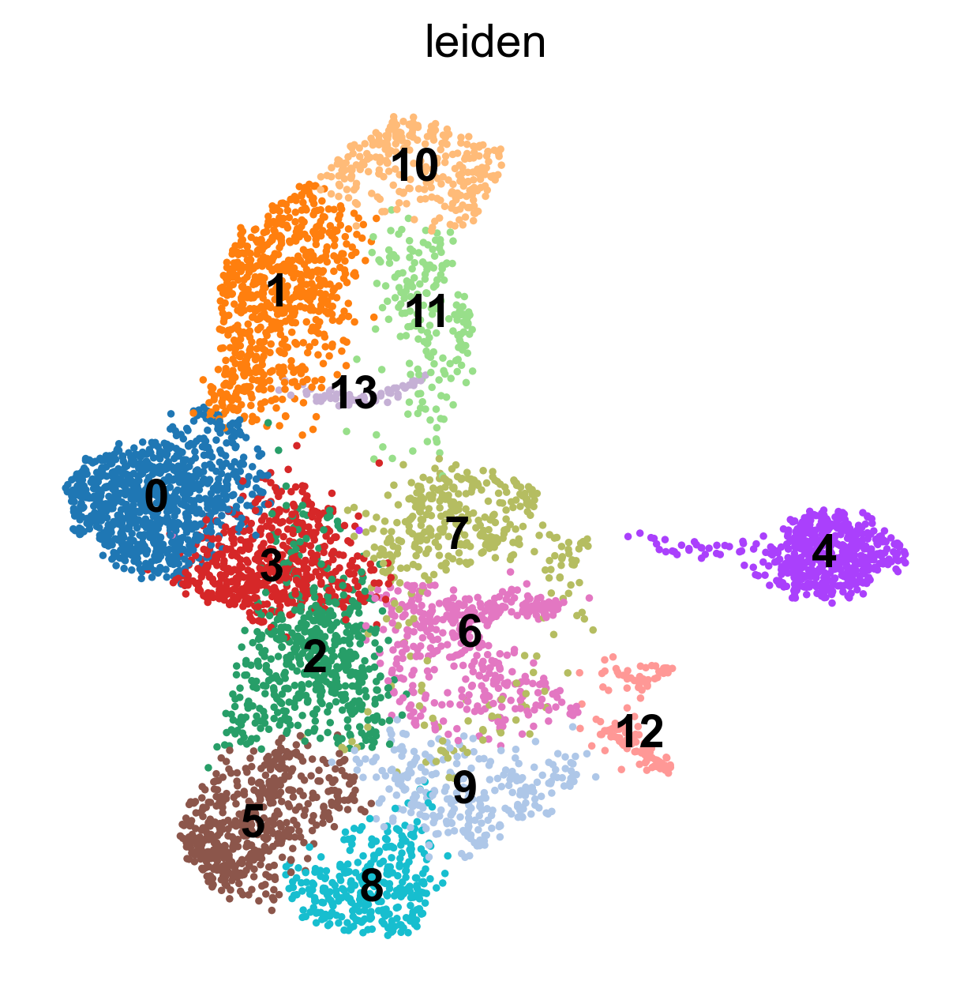

In [2]:
adata = sc.read_h5ad('data/setty_bone_marrow.h5ad')

sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, n_top_genes=2000)
sc.pp.pca(adata, use_highly_variable=True)
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(adata)

sc.pl.umap(adata, color='leiden',legend_loc='on data')

/home/lilizi/miniconda3/envs/blood/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


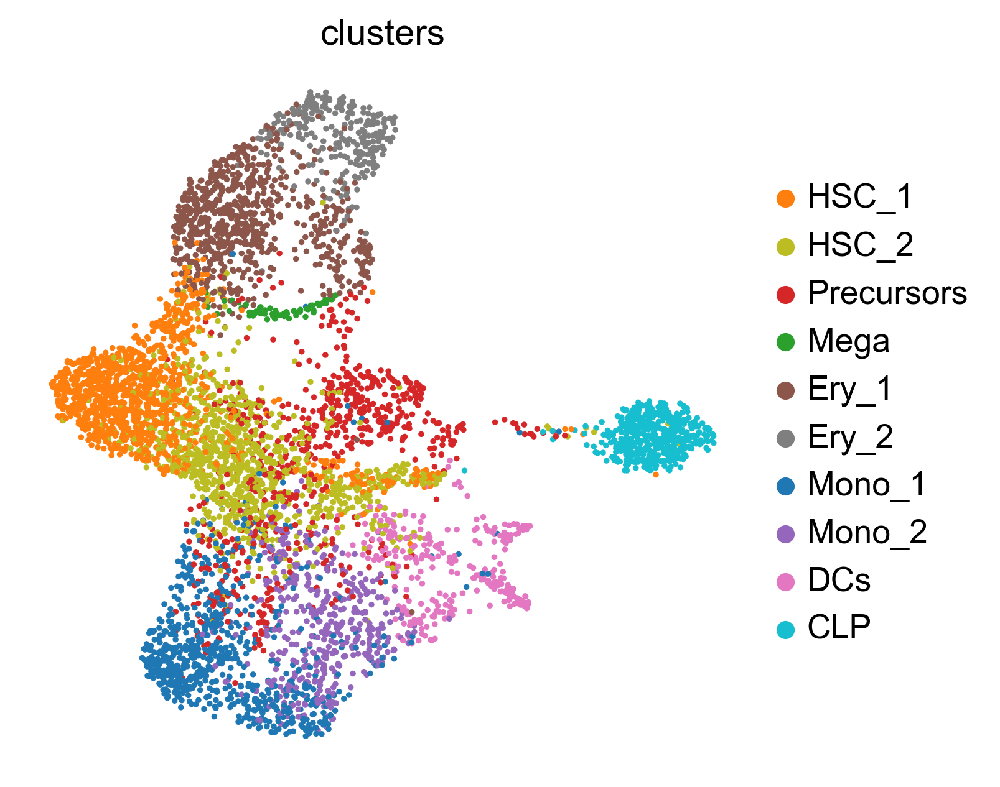

In [3]:
adata.obs['clusters'] = pd.Categorical(adata.obs['clusters']
                                       ,['HSC_1','HSC_2','Precursors','Mega','Ery_1'
                                         ,'Ery_2','Mono_1','Mono_2','DCs','CLP']
                                      )

clusters = adata.obs['clusters']

pal = sorted(sns.color_palette('tab10',n_colors=10),key=lambda x: x[2])

adata.uns['clusters_colors'] = pal

sc.pl.umap(adata, color='clusters', palette=pal)

/home/lilizi/miniconda3/envs/blood/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


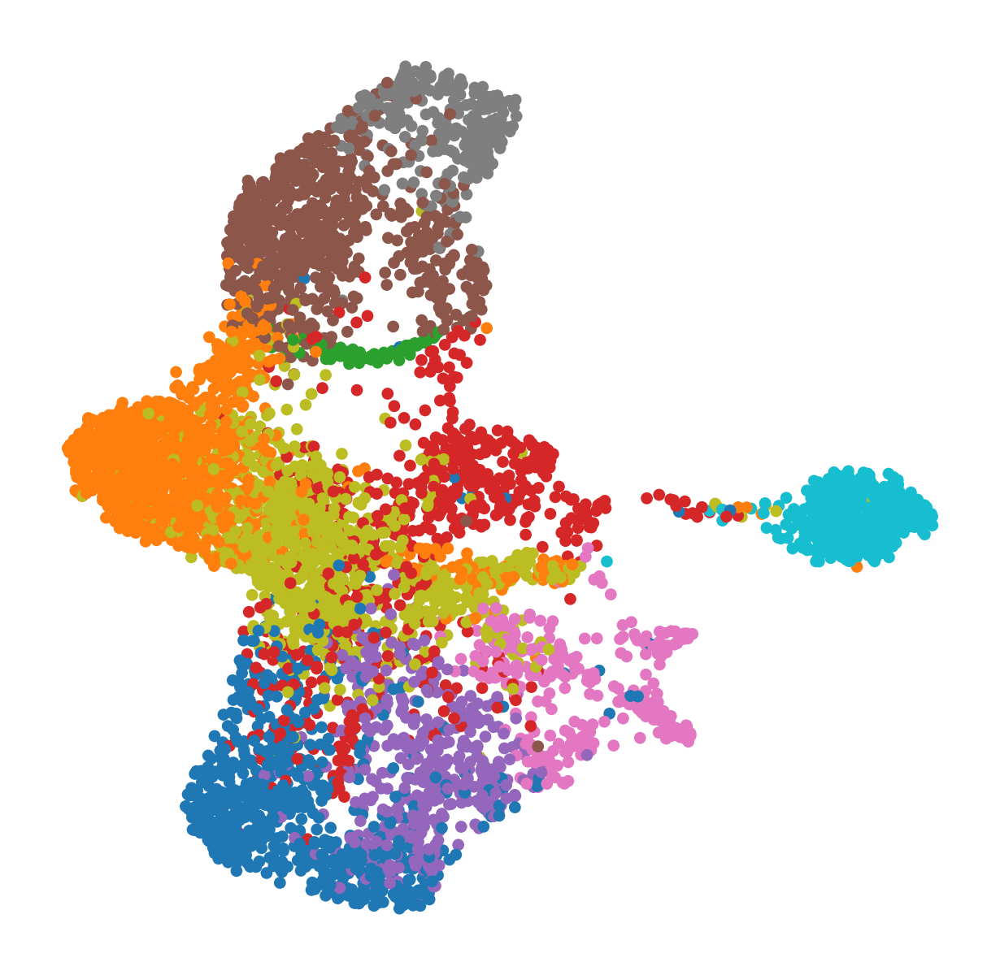

In [13]:
sc.pl.umap(adata, color='clusters', s=50,show=False,title='',legend_loc=None)
plt.savefig('F1.png',dpi=600,bbox_inches='tight')

In [4]:
hsc = pd.read_table('data/GSE117498_RAW/GSM3305359_HSC.raw_counts.tsv.gz',header=0,index_col=0).iloc[1:,:].T
mpp = pd.read_table('data/GSE117498_RAW/GSM3305360_MPP.raw_counts.tsv.gz',header=0,index_col=0).iloc[1:,:].T
mlp = pd.read_table('data/GSE117498_RAW/GSM3305361_MLP.raw_counts.tsv.gz',header=0,index_col=0).iloc[1:,:].T
prebnk = pd.read_table('data/GSE117498_RAW/GSM3305362_PreBNK.raw_counts.tsv.gz',header=0,index_col=0).iloc[1:,:].T
mep = pd.read_table('data/GSE117498_RAW/GSM3305363_MEP.raw_counts.tsv.gz',header=0,index_col=0).iloc[1:,:].T
cmp = pd.read_table('data/GSE117498_RAW/GSM3305364_CMP.raw_counts.tsv.gz',header=0,index_col=0).iloc[1:,:].T
gmp = pd.read_table('data/GSE117498_RAW/GSM3305365_GMP.raw_counts.tsv.gz',header=0,index_col=0).iloc[1:,:].T

/tmp/ipykernel_40175/2425512052.py:1: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata1 = ad(hsc).concatenate([ad(mpp),ad(mlp),ad(prebnk),ad(mep),ad(cmp),ad(gmp)], batch_categories=['HSC','MPP','MLP','PreBNK','MEP','CMP','GMP'])
/home/lilizi/miniconda3/envs/blood/lib/python3.9/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/home/lilizi/miniconda3/envs/blood/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provi

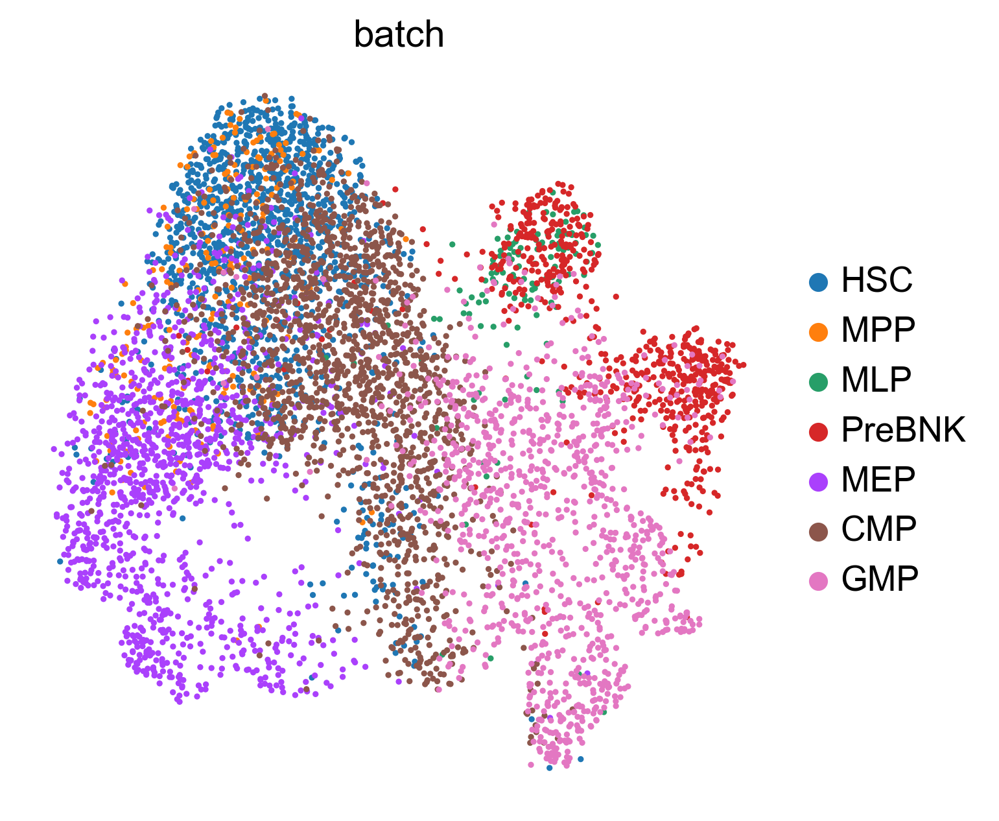

In [5]:
adata1 = ad(hsc).concatenate([ad(mpp),ad(mlp),ad(prebnk),ad(mep),ad(cmp),ad(gmp)], batch_categories=['HSC','MPP','MLP','PreBNK','MEP','CMP','GMP'])

sc.pp.normalize_total(adata1, target_sum=1e4)
sc.pp.log1p(adata1)
sc.pp.highly_variable_genes(adata1)
sc.pp.pca(adata1, use_highly_variable=True)
sc.pp.neighbors(adata1)
sc.tl.leiden(adata1)
sc.tl.umap(adata1)
sc.pl.umap(adata1, color='batch')

/home/lilizi/miniconda3/envs/blood/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lilizi/miniconda3/envs/blood/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


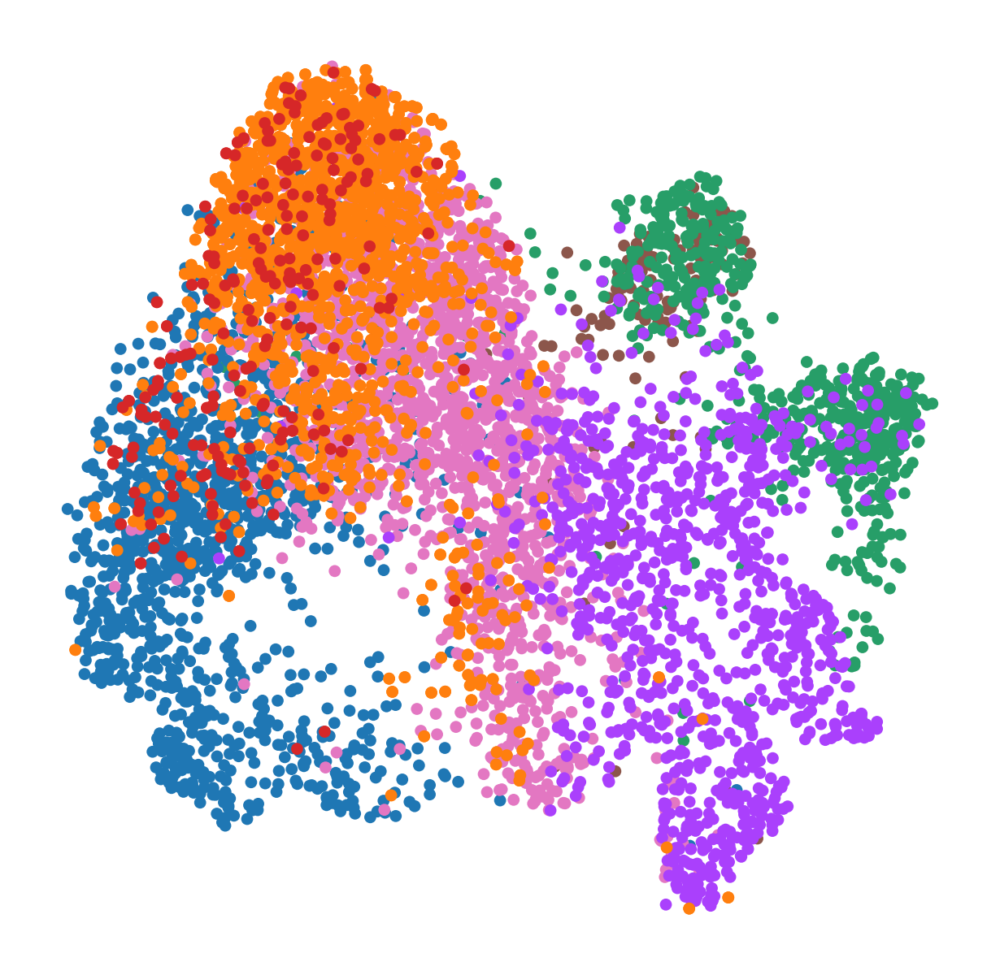

In [10]:
pal1 = sorted([mpl.colors.hex2color(c) for c in adata1.uns['batch_colors']],key=lambda x:x[2])

ax = sc.pl.umap(adata1, color='batch', palette=pal1,s=50,title='',frameon=False,legend_loc=None,show=False)
sc.pl.umap(adata1[adata1.obs['batch'].isin(['HSC','MPP'])], color='batch',s=50,title='',frameon=False,legend_loc=None,show=False,ax=ax)
plt.savefig('F2.png',dpi=600, bbox_inches='tight')

In [6]:
def procedure(adata, key, start):
    X = adata.obsm['X_umap']
    X_pca = adata.obsm['X_pca']
    clusters = adata.obs[key]

    gres = grids_from_embedding(X)

    gres = project_cluster(gres, clusters, cluster_colors=adata.uns[f'{key}_colors'])

    gres = align_pseudotime(gres, start)

    gres = project_back(gres, 'pseudotime')

    adata.obs['time'] = gres.embedding['pseudotime']
    return gres

In [7]:
gres = procedure(adata, 'clusters', 'HSC_1')

Adjacent generating: 100%|████████████████| 1163/1163 [00:00<00:00, 2303.05it/s]


Time used for mapping grids: 5.74 seconds
Time used for projecting annotation : 1.14 seconds
Time used for aligning pseudo-time : 0.67 seconds


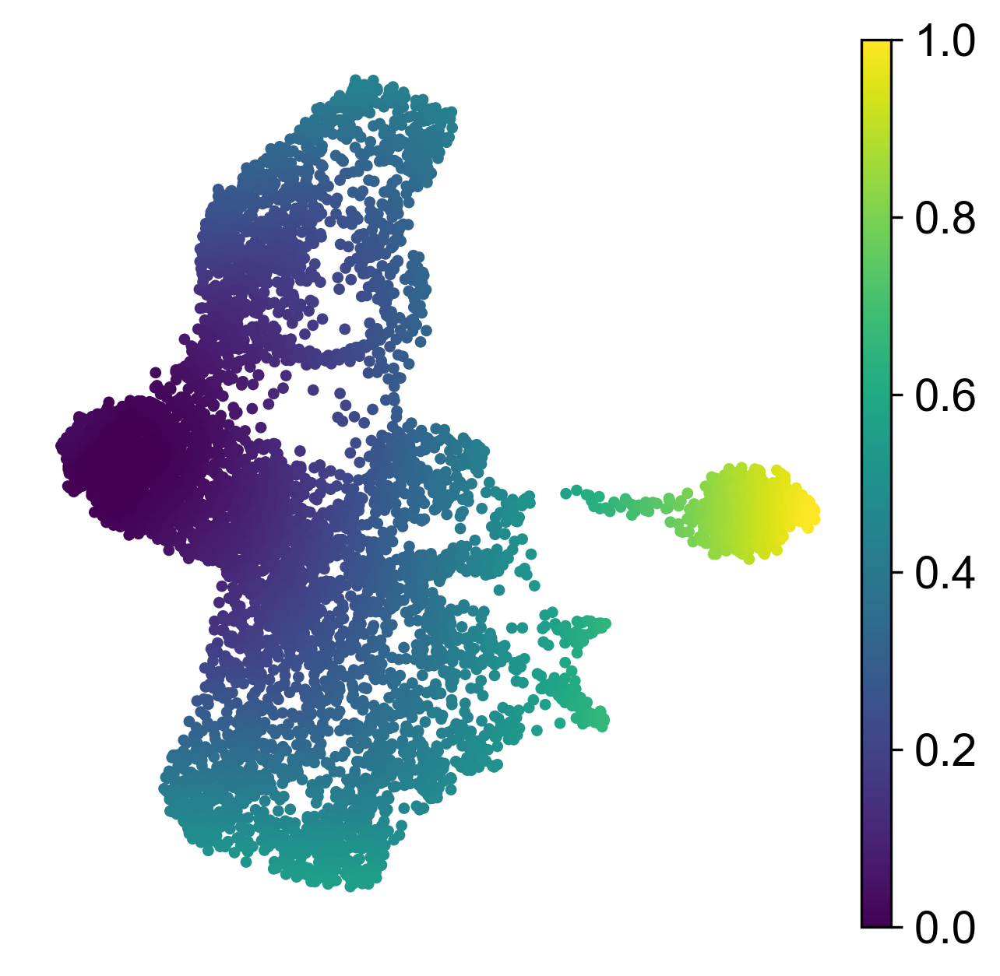

In [22]:
sc.pl.umap(adata, color='time',s=50,title='',show=False)
plt.savefig('F3.png',dpi=600,bbox_inches='tight')

In [8]:
gres1 = procedure(adata1, 'batch', 'HSC')

Adjacent generating: 100%|████████████████| 1699/1699 [00:00<00:00, 2144.77it/s]


Time used for mapping grids: 6.06 seconds
Time used for projecting annotation : 1.02 seconds
Time used for aligning pseudo-time : 0.61 seconds


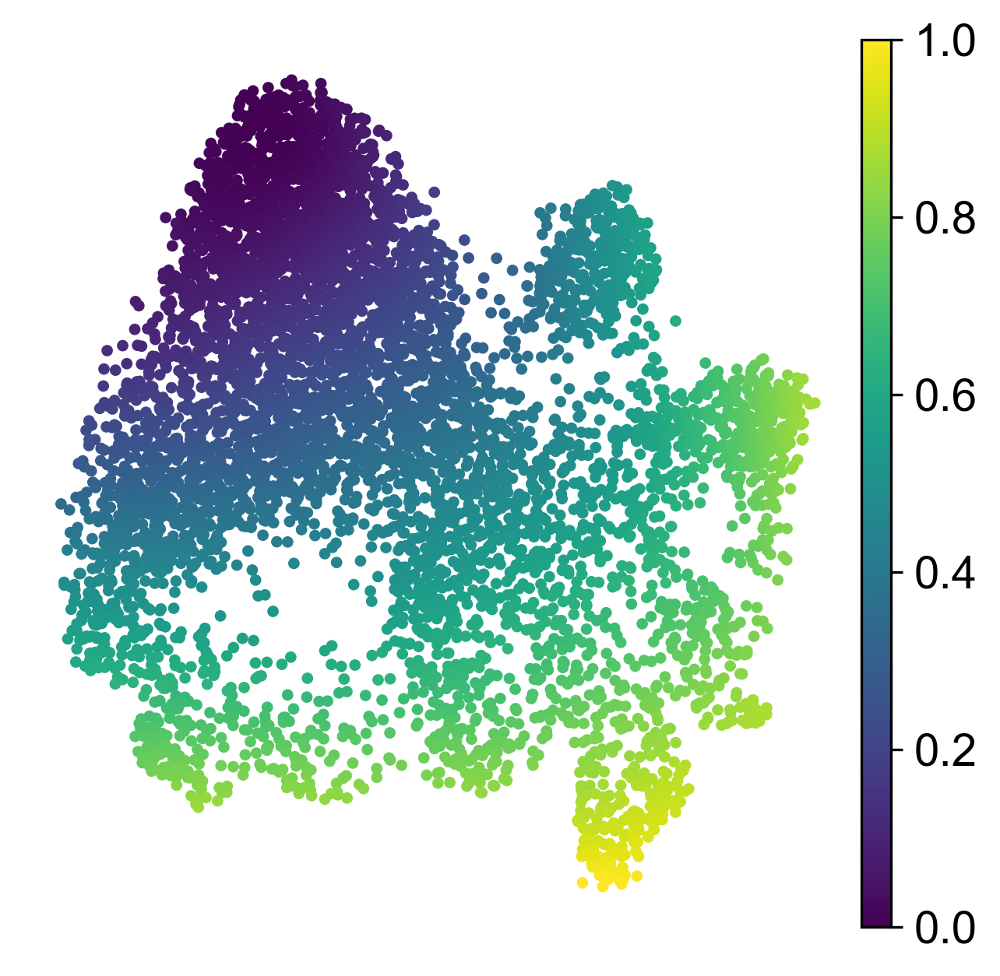

In [23]:
sc.pl.umap(adata1, color='time',s=50,title='',show=False)
plt.savefig('F4.png',dpi=600,bbox_inches='tight')

In [58]:
start = 'Run4_195606431320494'
sc.tl.diffmap(adata)
adata.uns['iroot'] = np.where(adata.obs_names == start)[0].item()
sc.tl.dpt(adata)

start1 = adata1.obs_names[np.argmax(adata1.obsm['X_umap'][:,1])]
sc.tl.diffmap(adata1)
adata1.uns['iroot'] = np.argmax(adata1.obsm['X_umap'][:,1])
sc.tl.dpt(adata1)

In [31]:
from wishbone import wb

res = wb.c_wishbone(adata.obsm['X_diffmap'][:, [1,2]],
        s=np.where(adata.obs_names == start)[0]
        )

res1 = wb.c_wishbone(adata1.obsm['X_diffmap'][:, [1,2]],
        s=np.where(adata1.obs_names == start1)[0]
        )

adata.obs['wishbone_pseudotime'] = res['Trajectory']

adata1.obs['wishbone_pseudotime'] = res1['Trajectory']

In [196]:
import scanpy.external as sce

In [64]:
sce.tl.palantir(adata)

pr_res = sce.tl.palantir_results(adata, early_cell=start)

In [198]:
sns.set_style('ticks')

In [64]:
adata.obs['palantir_pseudotime'] = pr_res.pseudotime

In [197]:
sce.tl.palantir(adata1)

pr_res1 = sce.tl.palantir_results(adata1, early_cell=start1)

adata1.obs['palantir_pseudotime'] = pr_res1.pseudotime

findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.


Determing nearest neighbor graph...
Sampling and flocking waypoints...
Time for determining waypoints: 0.008221256732940673 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...


findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back t

Time for shortest paths: 0.12091676791508993 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9996
Correlation at iteration 2: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Identification of terminal states...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


In [40]:
adata[:,adata.var['highly_variable']].to_df().T.to_csv('cd34exp.csv')
g = adata[:,adata.var['highly_variable']].var_names
pd.DataFrame({'gene':g,'gene_short_names':g}).to_csv('cd34fdata.csv')
adata.obs.to_csv('cd34pdata.csv')

adata1[:,adata1.var['highly_variable']].to_df().T.to_csv('phenoexp.csv')
g = adata1[:,adata1.var['highly_variable']].var_names
pd.DataFrame({'gene':g,'gene_short_names':g}).to_csv('phenofdata.csv')
adata1.obs.to_csv('phenopdata.csv')

In [43]:
adata.obs['monocle_time'] = pd.read_csv('mpt.csv',header=0,index_col=0).values
adata.obs['monocle3_time'] = pd.read_csv('mpt3.csv',header=0,index_col=0).values

adata1.obs['monocle_time'] = pd.read_csv('../../../phenompt.csv',header=0,index_col=0).values
adata1.obs['monocle3_time'] = pd.read_csv('../../../phenompt3.csv',header=0,index_col=0).values

In [50]:
adata.obs['umap_dis'] = np.linalg.norm(adata.obsm['X_umap'][adata.uns['iroot'],:]-adata.obsm['X_umap'], axis=1)

adata1.obs['umap_dis'] = np.linalg.norm(adata1.obsm['X_umap'][adata1.uns['iroot'],:]-adata1.obsm['X_umap'], axis=1)

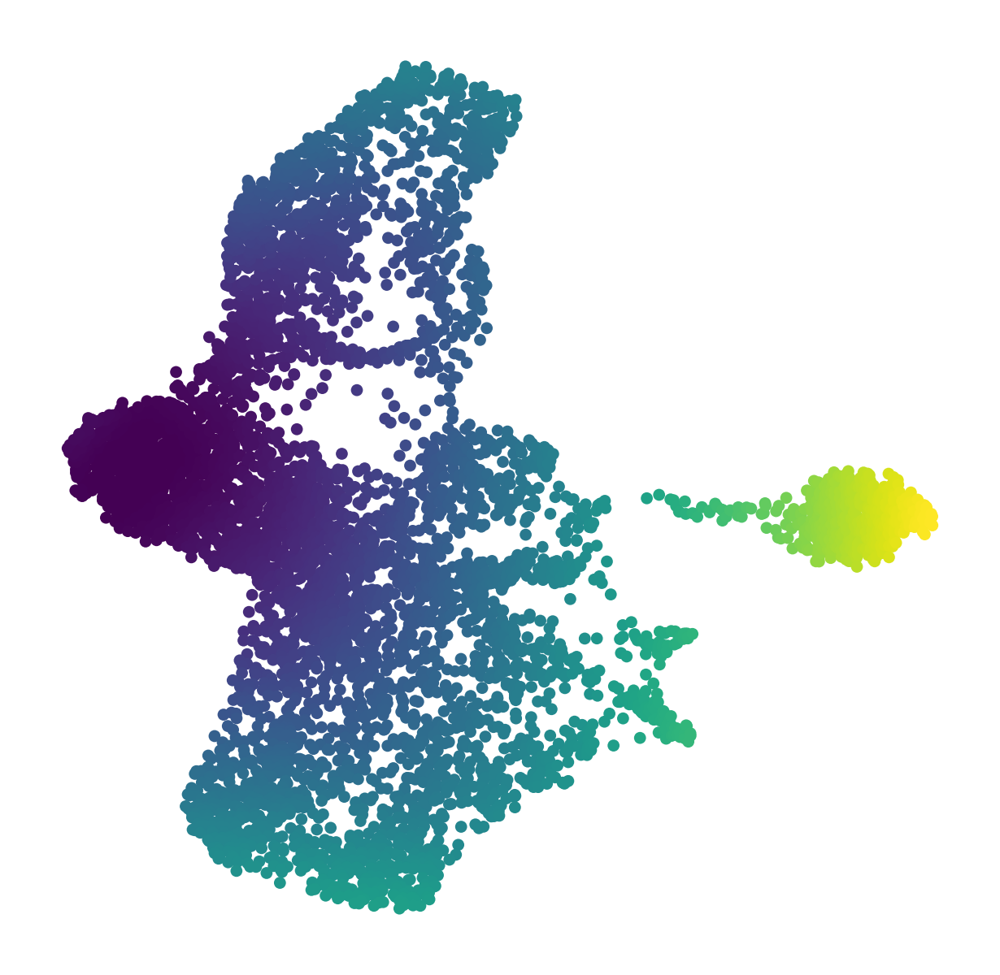

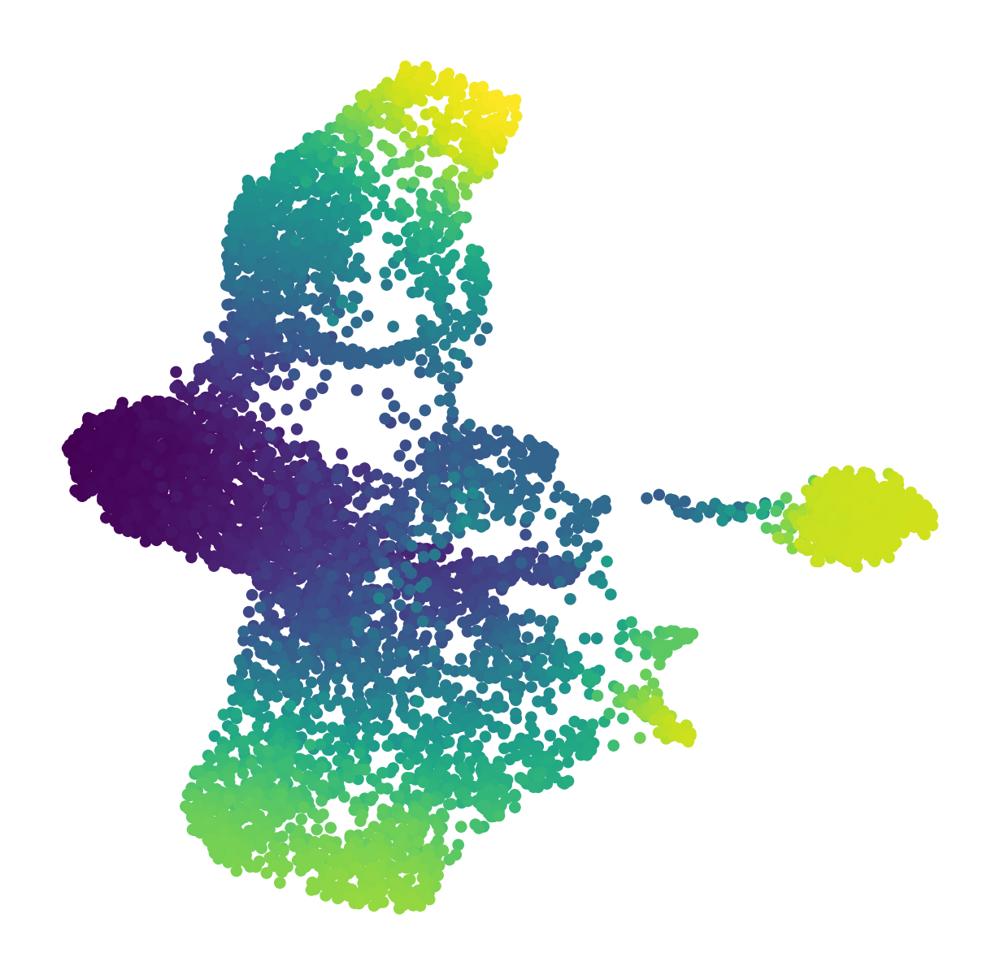

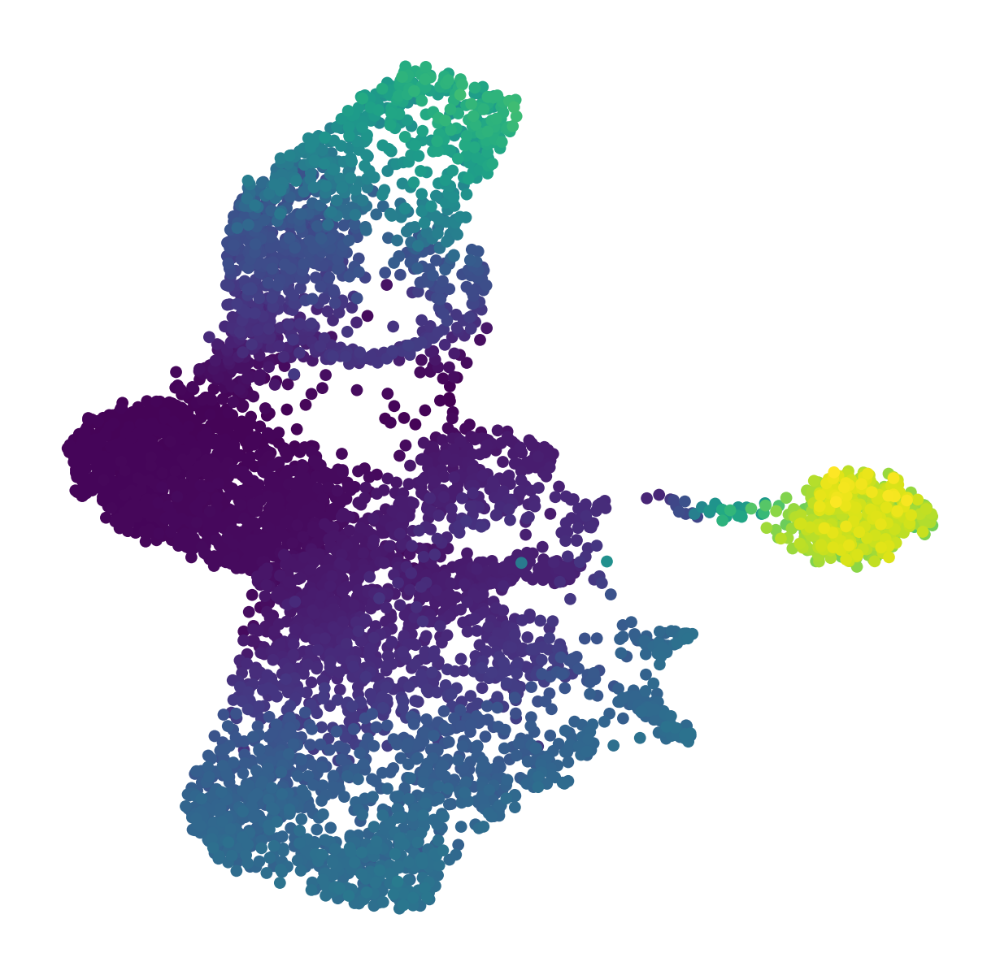

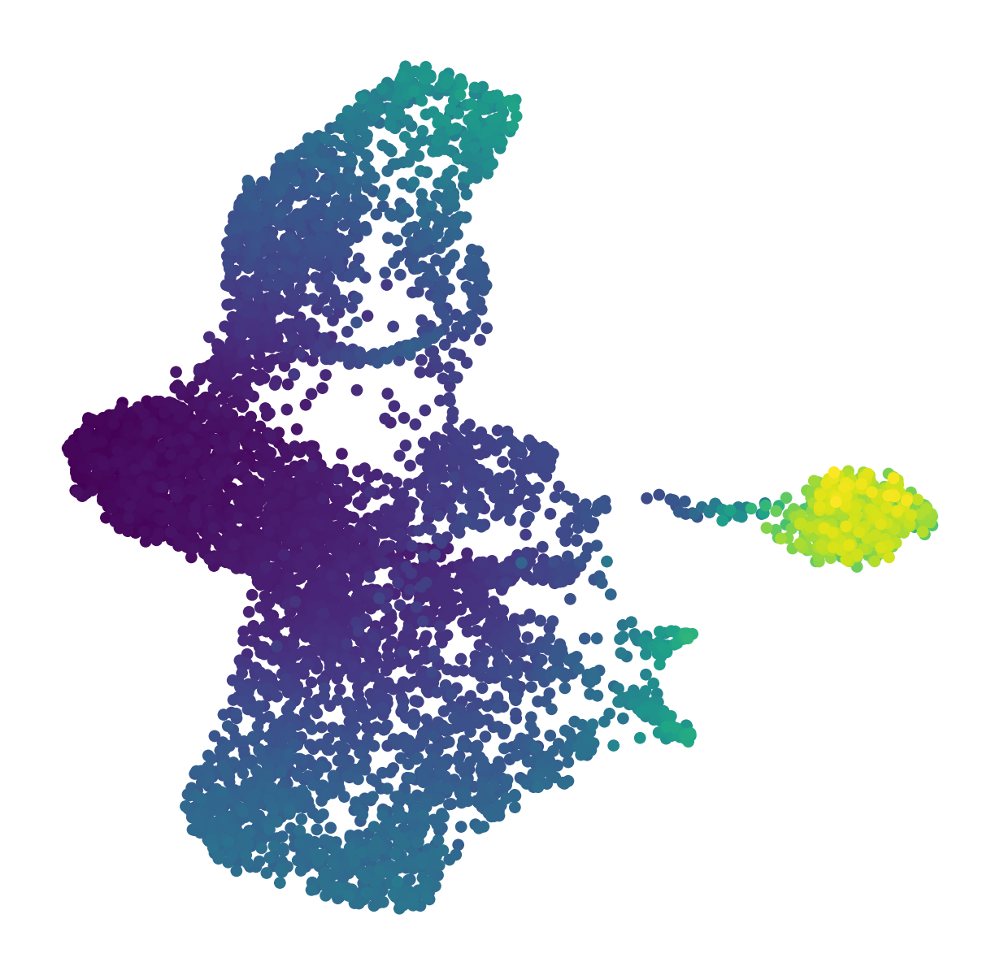

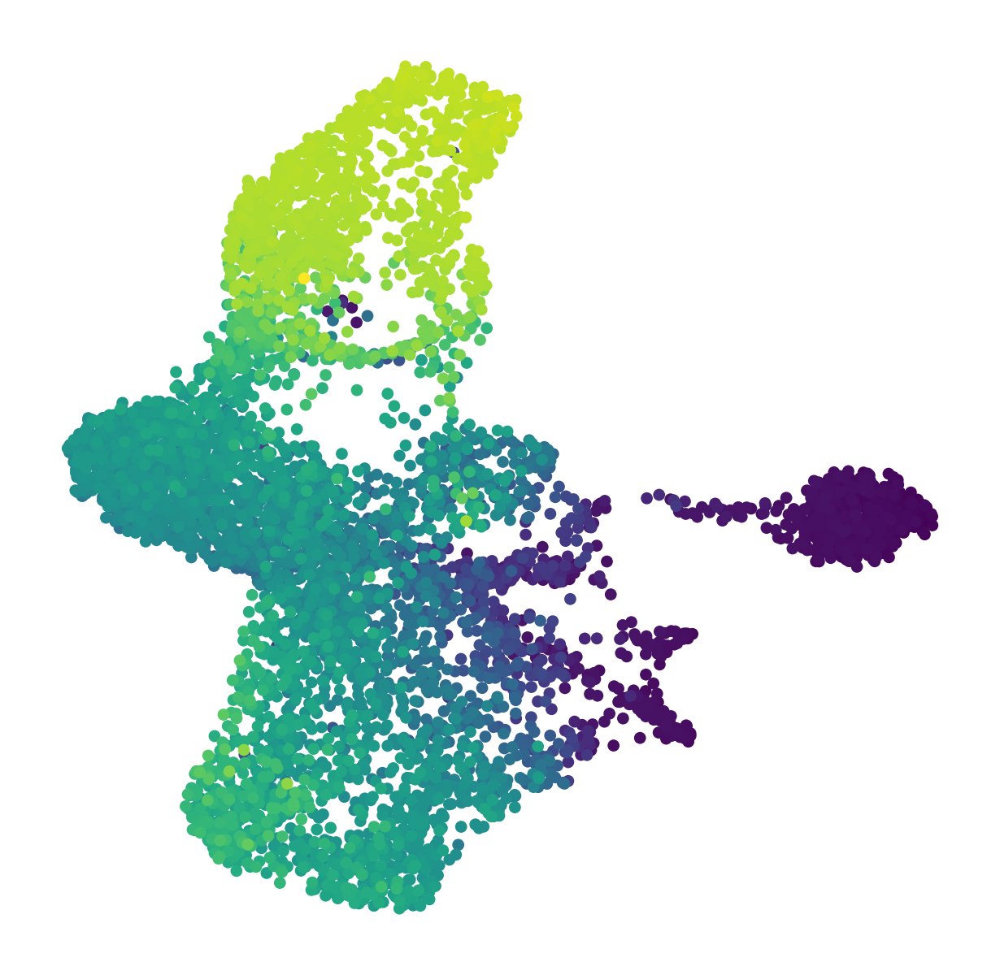

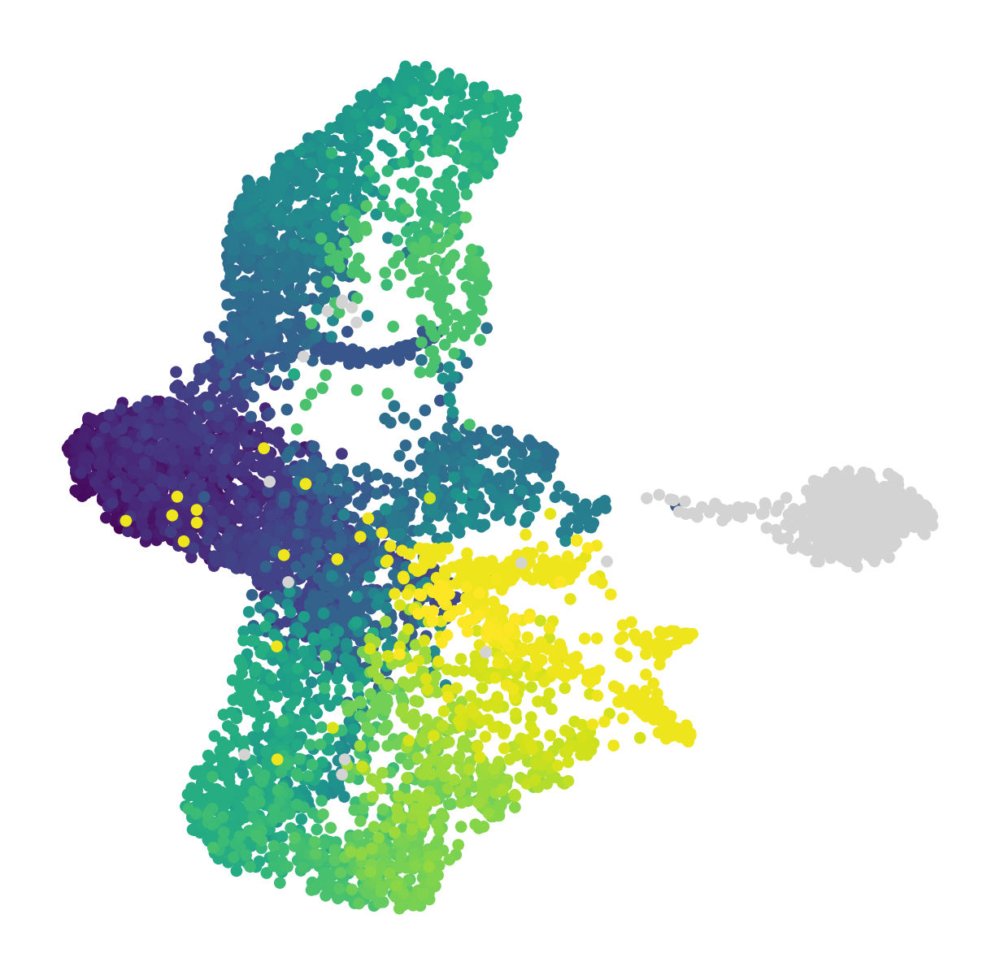

In [16]:
for i, t in enumerate(['time','palantir_pseudotime','wishbone_pseudotime','dpt_pseudotime','monocle_time','monocle3_time']):
    adata.obs[t] = times[t]
    sc.pl.umap(adata, color=t,s=50,show=False,colorbar_loc=None,title='')
    plt.savefig(f'F5_{i}.png',dpi=600,bbox_inches='tight')

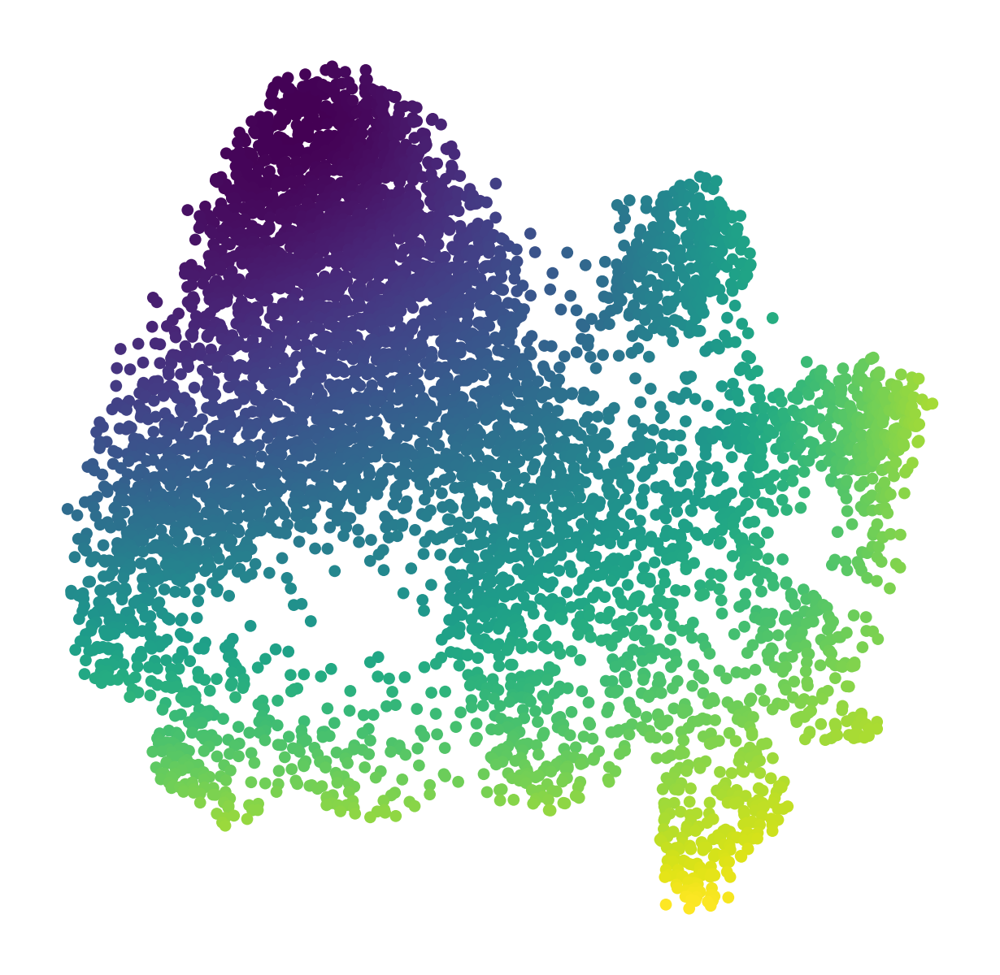

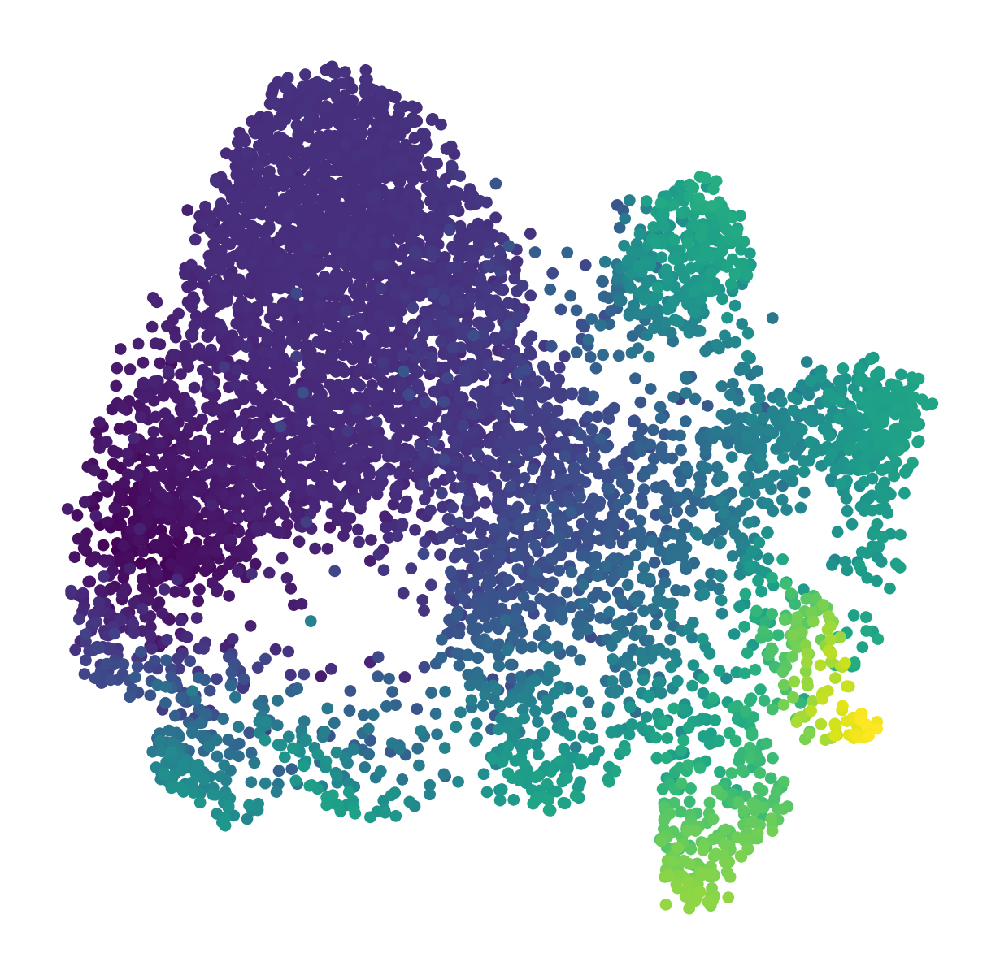

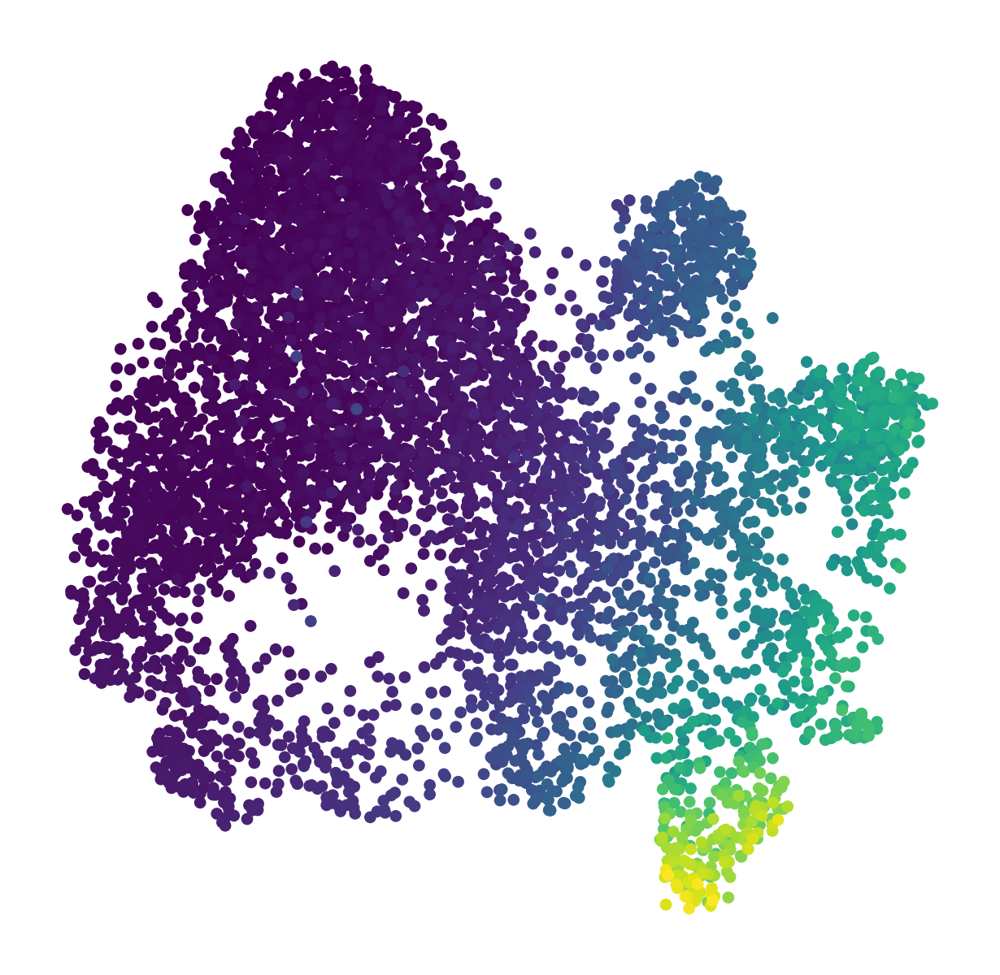

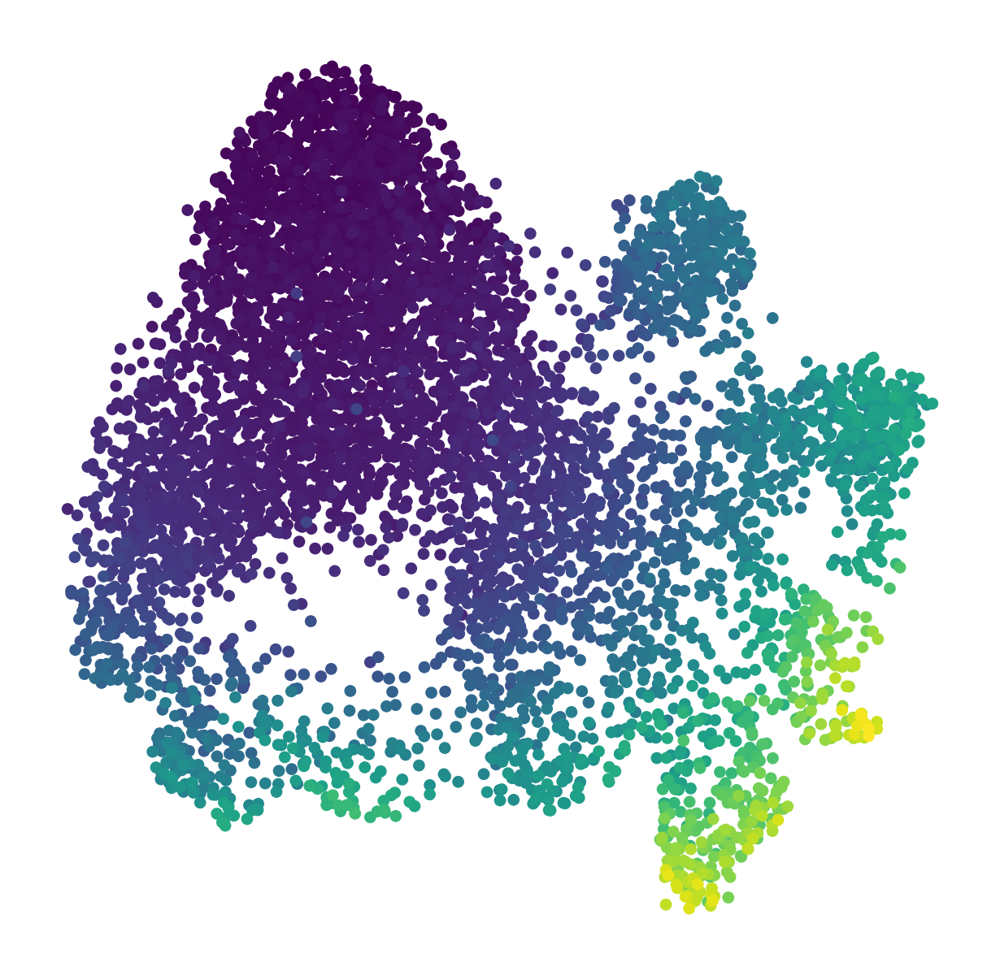

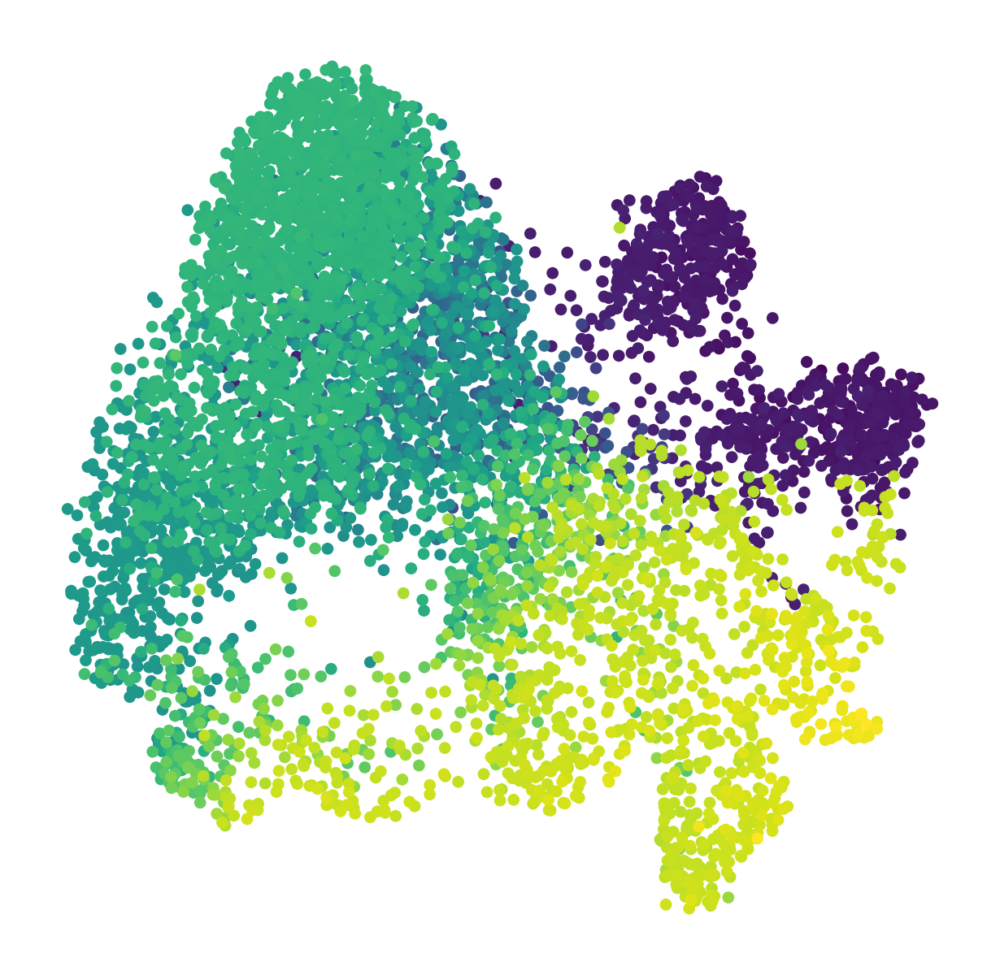

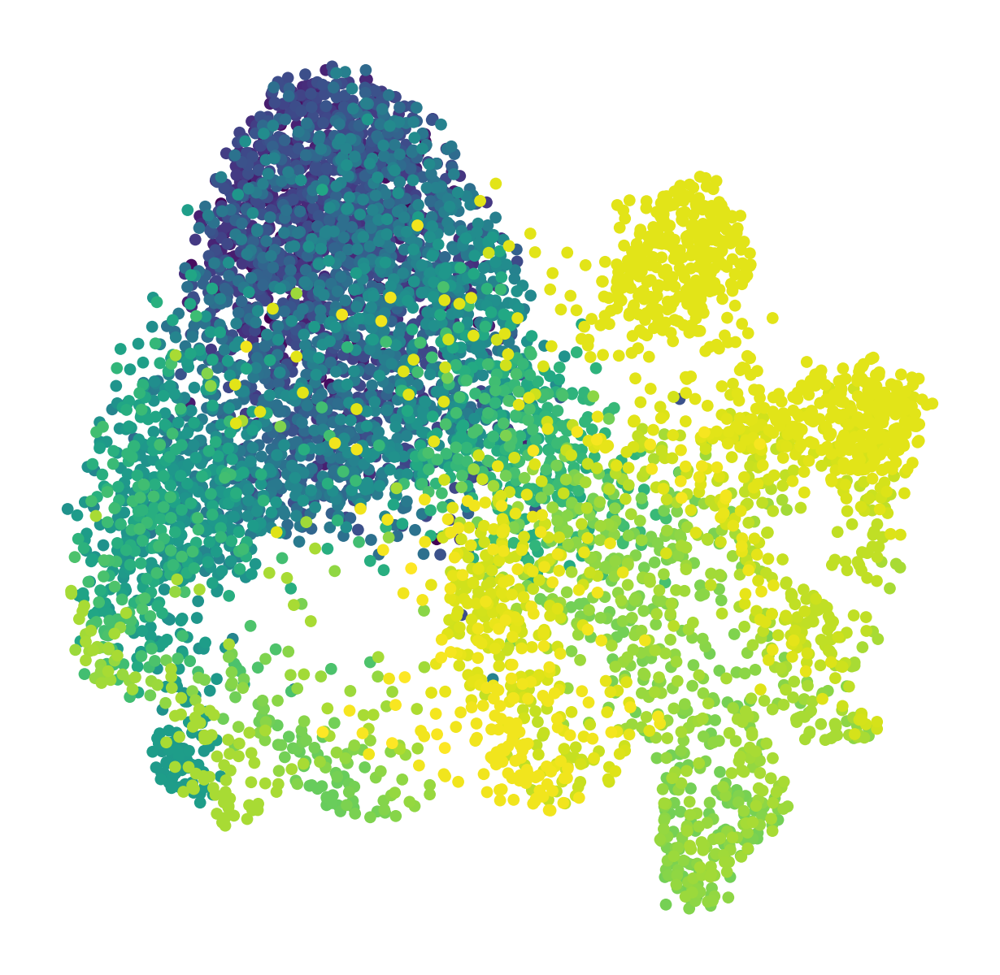

In [19]:
for i, t in enumerate(['time','palantir_pseudotime','wishbone_pseudotime','dpt_pseudotime','monocle_time','monocle3_time']):
    adata1.obs[t] = times1[t]
    sc.pl.umap(adata1, color=t,s=50,show=False,colorbar_loc=None,title='')
    plt.savefig(f'F6_{i}.png',dpi=600,bbox_inches='tight')

In [73]:
adata.obs[['umap_dis','time','palantir_pseudotime','wishbone_pseudotime','dpt_pseudotime','monocle_time','monocle3_time']].to_csv('cd34_times.csv')

In [74]:
adata1.obs[['umap_dis','time','palantir_pseudotime','wishbone_pseudotime','dpt_pseudotime','monocle_time','monocle3_time']].to_csv('pheno_times.csv')

In [13]:
times = pd.read_csv('cd34_times.csv',header=0,index_col=0)
times1 = pd.read_csv('pheno_times.csv',header=0,index_col=0)

In [56]:
adata.obs[['umap_dis','time','palantir_pseudotime','wishbone_pseudotime','dpt_pseudotime','monocle_time','monocle3_time']].corr()

,umap_dis,time,palantir_pseudotime,wishbone_pseudotime,dpt_pseudotime,monocle_time,monocle3_time
umap_dis,1.000000,0.968365,0.893793,0.846124,0.897445,-0.403734,0.862021
time,0.968365,1.000000,0.845803,0.876461,0.936078,-0.526510,0.855501
palantir_pseudotime,0.893793,0.845803,1.000000,0.876030,0.874180,-0.065465,0.691234
wishbone_pseudotime,0.846124,0.876461,0.876030,1.000000,0.975520,-0.247391,0.583827
dpt_pseudotime,0.897445,0.936078,0.874180,0.975520,1.000000,-0.371213,0.713829
monocle_time,-0.403734,-0.526510,-0.065465,-0.247391,-0.371213,1.000000,-0.223607
monocle3_time,0.862021,0.855501,0.691234,0.583827,0.713829,-0.223607,1.000000


In [68]:
adata.obs[['umap_dis','time','palantir_pseudotime','wishbone_pseudotime','dpt_pseudotime','monocle_time','monocle3_time']].corr(method='spearman')

,umap_dis,time,palantir_pseudotime,wishbone_pseudotime,dpt_pseudotime,monocle_time,monocle3_time
umap_dis,1.000000,0.987028,0.910618,0.892078,0.933179,-0.251680,0.881750
time,0.987028,1.000000,0.886383,0.861972,0.914707,-0.287535,0.869918
palantir_pseudotime,0.910618,0.886383,1.000000,0.967446,0.980356,0.064501,0.764251
wishbone_pseudotime,0.892078,0.861972,0.967446,1.000000,0.977595,0.040673,0.740726
dpt_pseudotime,0.933179,0.914707,0.980356,0.977595,1.000000,-0.010969,0.780016
monocle_time,-0.251680,-0.287535,0.064501,0.040673,-0.010969,1.000000,-0.065490
monocle3_time,0.881750,0.869918,0.764251,0.740726,0.780016,-0.065490,1.000000


In [69]:
adata.obs[['umap_dis','time','palantir_pseudotime','wishbone_pseudotime','dpt_pseudotime','monocle_time','monocle3_time']].corr(method='kendall')

,umap_dis,time,palantir_pseudotime,wishbone_pseudotime,dpt_pseudotime,monocle_time,monocle3_time
umap_dis,1.000000,0.914122,0.759110,0.721722,0.785419,-0.165547,0.702206
time,0.914122,1.000000,0.729621,0.687235,0.758143,-0.189250,0.686804
palantir_pseudotime,0.759110,0.729621,1.000000,0.843980,0.879671,0.040376,0.595386
wishbone_pseudotime,0.721722,0.687235,0.843980,1.000000,0.885222,0.028135,0.541465
dpt_pseudotime,0.785419,0.758143,0.879671,0.885222,1.000000,0.000868,0.601444
monocle_time,-0.165547,-0.189250,0.040376,0.028135,0.000868,1.000000,-0.033961
monocle3_time,0.702206,0.686804,0.595386,0.541465,0.601444,-0.033961,1.000000


In [67]:
adata1.obs[['umap_dis','time','palantir_pseudotime','wishbone_pseudotime','dpt_pseudotime','monocle_time','monocle3_time']].corr()

,umap_dis,time,palantir_pseudotime,wishbone_pseudotime,dpt_pseudotime,monocle_time,monocle3_time
umap_dis,1.000000,0.976782,0.728338,0.743226,0.881044,0.212012,0.768849
time,0.976782,1.000000,0.807974,0.794167,0.914937,0.124536,0.814106
palantir_pseudotime,0.728338,0.807974,1.000000,0.908804,0.937603,0.060842,0.691790
wishbone_pseudotime,0.743226,0.794167,0.908804,1.000000,0.916202,0.025952,0.651030
dpt_pseudotime,0.881044,0.914937,0.937603,0.916202,1.000000,0.152000,0.730693
monocle_time,0.212012,0.124536,0.060842,0.025952,0.152000,1.000000,-0.090880
monocle3_time,0.768849,0.814106,0.691790,0.651030,0.730693,-0.090880,1.000000


In [70]:
adata1.obs[['umap_dis','time','palantir_pseudotime','wishbone_pseudotime','dpt_pseudotime','monocle_time','monocle3_time']].corr(method='spearman')

,umap_dis,time,palantir_pseudotime,wishbone_pseudotime,dpt_pseudotime,monocle_time,monocle3_time
umap_dis,1.000000,0.977493,0.587837,0.789439,0.951279,0.265922,0.756017
time,0.977493,1.000000,0.699308,0.864583,0.968940,0.182283,0.805172
palantir_pseudotime,0.587837,0.699308,1.000000,0.841612,0.705644,0.153153,0.673639
wishbone_pseudotime,0.789439,0.864583,0.841612,1.000000,0.890381,0.057648,0.787674
dpt_pseudotime,0.951279,0.968940,0.705644,0.890381,1.000000,0.144937,0.833106
monocle_time,0.265922,0.182283,0.153153,0.057648,0.144937,1.000000,-0.003457
monocle3_time,0.756017,0.805172,0.673639,0.787674,0.833106,-0.003457,1.000000


In [71]:
adata1.obs[['umap_dis','time','palantir_pseudotime','wishbone_pseudotime','dpt_pseudotime','monocle_time','monocle3_time']].corr(method='kendall')

,umap_dis,time,palantir_pseudotime,wishbone_pseudotime,dpt_pseudotime,monocle_time,monocle3_time
umap_dis,1.000000,0.875926,0.392881,0.594686,0.821572,0.150719,0.534956
time,0.875926,1.000000,0.491095,0.675882,0.842827,0.080135,0.580485
palantir_pseudotime,0.392881,0.491095,1.000000,0.648919,0.499077,0.107146,0.429151
wishbone_pseudotime,0.594686,0.675882,0.648919,1.000000,0.727705,0.007227,0.555583
dpt_pseudotime,0.821572,0.842827,0.499077,0.727705,1.000000,0.069726,0.611368
monocle_time,0.150719,0.080135,0.107146,0.007227,0.069726,1.000000,0.000199
monocle3_time,0.534956,0.580485,0.429151,0.555583,0.611368,0.000199,1.000000


In [22]:
X_pca = adata.obsm['X_pca']
X_pca1 = adata1.obsm['X_pca']

In [20]:
gres = lineage_rewards(gres, ['HSC_1','HSC_2'], ['Ery_1','Ery_2','Mega'], mode='Contribution')

In [210]:
gres1 = lineage_rewards(gres1, ['HSC','MPP'], ['MEP'], mode='Contribution')

Reward generating: 100%|██████████████████| 1699/1699 [00:00<00:00, 2719.81it/s]

Time used for generating rewards : 0.65 seconds


In [20]:
t_ery = trainer('ActorCritic', gres, reward_mode='Contribution', X_latent=X_pca, num_episodes=5e3)
t_ery.train()

In [214]:
t_ery1 = trainer('ActorCritic', gres1, reward_mode='Contribution', X_latent=X_pca1, num_episodes=5e3)
t_ery1.train()

Iteration10: 100%|████████████| 500/500 [00:07<00:00, 70.62it/s, E=5000, R=8.95]


([-1.0,
  -0.9120472399454435,
  0.2385996355282271,
  -0.6351028949225641,
  -2,
  -1.0,
  -1.0,
  -1.0,
  -0.8135489302211806,
  0.15964423254712884,
  -1.0,
  -0.9207748984453747,
  -0.9207748984453747,
  -0.7732577404831906,
  -0.8592096231396673,
  -0.3070031725302924,
  -0.592260016295893,
  -1.0,
  -1.0,
  -1.9656820546492288,
  0.598740114039227,
  -1.0,
  -1.0,
  -0.8696342659522577,
  -0.93751492968221,
  -1.0,
  -1.0,
  -2.0,
  -0.7490954336047507,
  -1.0,
  -1.0,
  -1.0,
  -0.2424468176746727,
  -1.0,
  -1.0,
  -0.914947228730031,
  -1.0,
  1.8507556150364182,
  -1.0,
  -1.0,
  -2.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  0.021739130434782636,
  0.14177013350623247,
  -1.0,
  0.005434782608695656,
  -1.0,
  -1.0,
  -0.47124320831805344,
  -1.0,
  -2,
  -0.6533391349593307,
  -0.558840212311459,
  -0.9656820546492288,
  -1.0,
  -1.0,
  -1.0,
  -0.5998287320415083,
  -1.0,
  -0.4046382160669887,
  0.024456521739130377,
  -0.9718328750329811,
  -1.0,
  -0.6618618618640273,
  -0.296

In [28]:
gres.grids['Ery'] = t_ery.agent.critic(torch.tensor(t_ery.env.state_space.mean(axis=1),device=device)).detach().cpu().numpy().ravel()
gres = project_back(gres, 'Ery')
adata.obs['Ery'] = gres.embedding['Ery']

In [215]:
gres1.grids['Ery'] = t_ery1.agent.critic(torch.tensor(t_ery1.env.state_space.mean(axis=1),device=device)).detach().cpu().numpy().ravel()
gres1 = project_back(gres1, 'Ery')
adata1.obs['Ery'] = gres1.embedding['Ery']

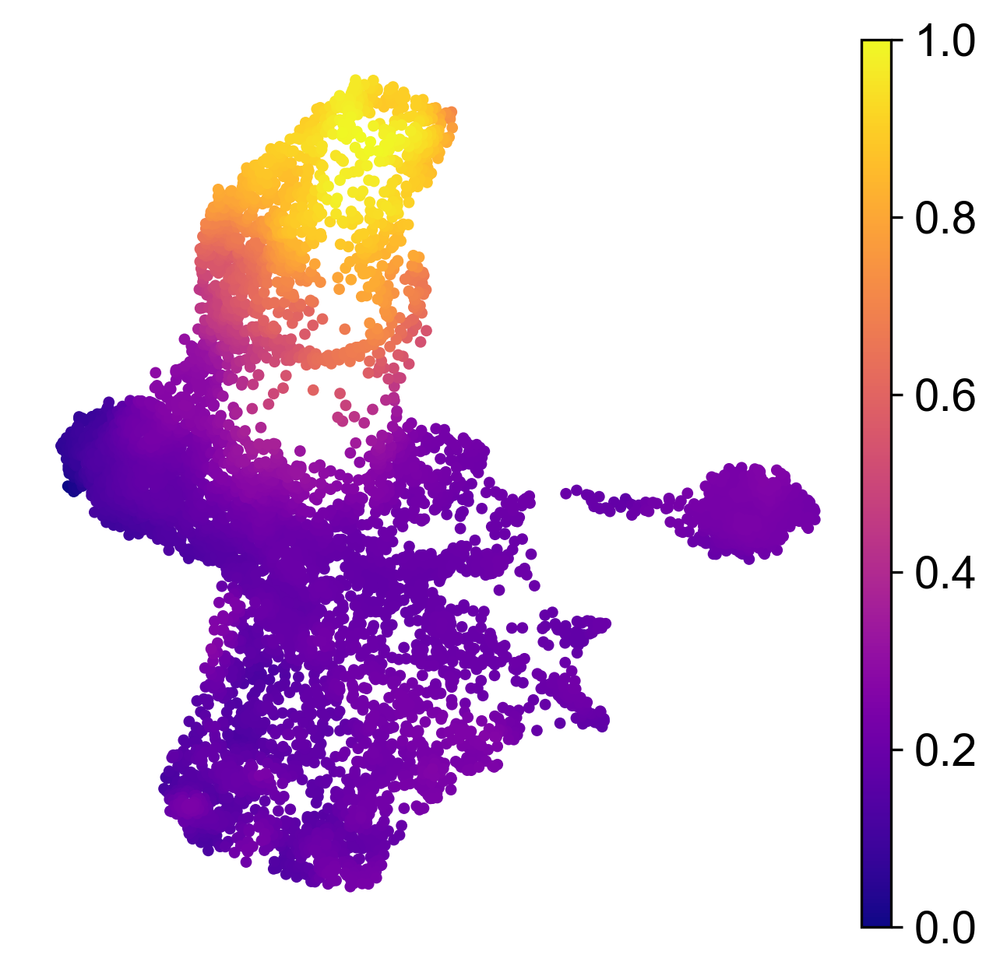

In [33]:
sc.pl.umap(adata, color='Ery',s=50,title='',cmap='plasma',show=False)
plt.savefig('F7.png',dpi=600,bbox_inches='tight')

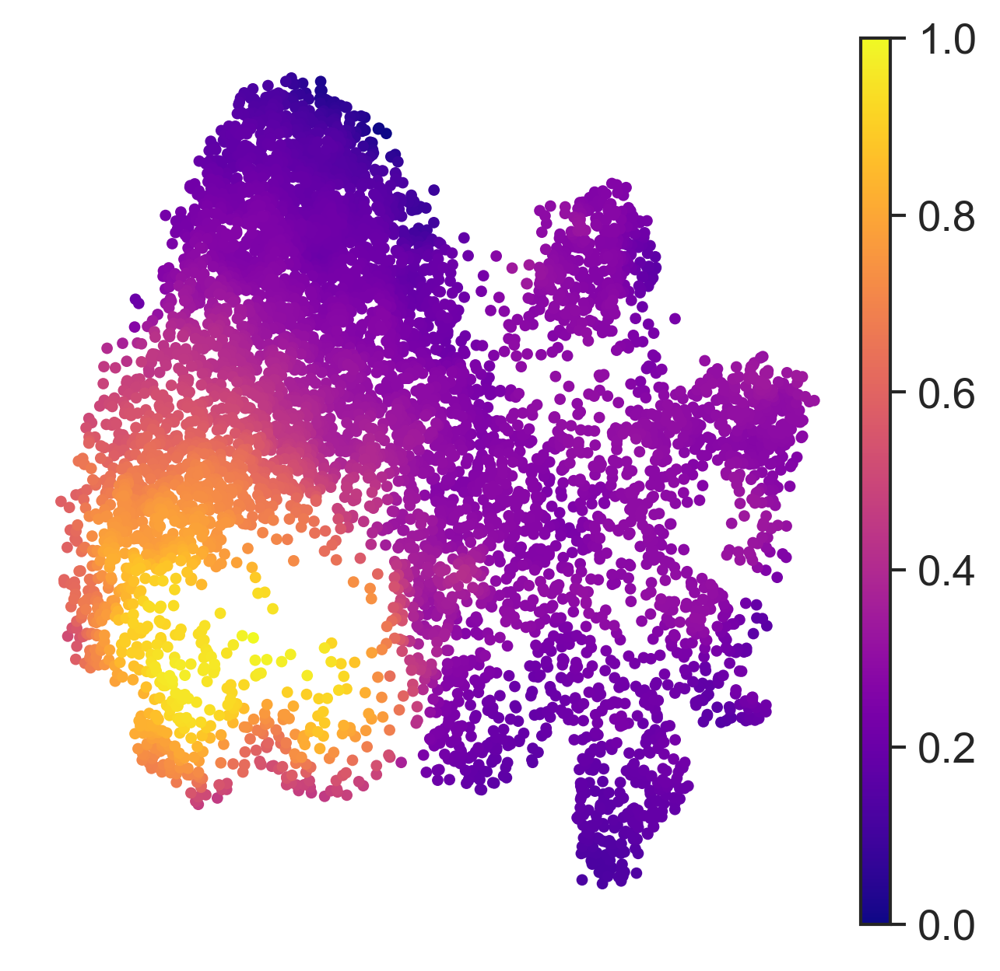

In [216]:
sc.pl.umap(adata1, color='Ery',s=50,title='',cmap='plasma',show=False)
plt.savefig('F8.png',dpi=600,bbox_inches='tight')

In [172]:
gres = lineage_rewards(gres, ['HSC_1','HSC_2'], ['Mono_1','Mono_2','DCs'], mode='Contribution')

Reward generating: 100%|██████████████████| 1163/1163 [00:00<00:00, 2446.68it/s]

Time used for generating rewards : 0.50 seconds


In [218]:
gres1 = lineage_rewards(gres1, ['HSC','MPP'], ['GMP'], mode='Contribution')

Reward generating: 100%|██████████████████| 1699/1699 [00:00<00:00, 2497.06it/s]

Time used for generating rewards : 0.71 seconds


In [173]:
t_mye = trainer('ActorCritic', gres, reward_mode='Contribution', X_latent=X_pca, num_episodes=5e3)
t_mye.train()

Iteration10: 100%|████████████| 500/500 [00:07<00:00, 68.98it/s, E=5000, R=6.77]


([-1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -2,
  -1.0,
  -0.7303062662743388,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -2.0,
  0.15293603128073396,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -2,
  -0.8322059498408995,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -0.7426960858895953,
  -1.0,
  -1.0,
  -2,
  -1.0,
  -0.8323150002058387,
  -1.0,
  -1.0,
  0.026058631921824144,
  1.3829519039438143,
  -0.9386701501888537,
  -1.0,
  -0.8218457680455684,
  -2.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  1.2479796632282603,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -0.9688499110743902,
  -1.0,
  -2,
  -1.0,
  -0.17840819555099152,
  0.30285978486401555,
  -2,
  -1.0,
  -0.9566632814389918,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -2,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -0.7912215869868346,
  0.48257672924902506,
  -1

In [219]:
t_mye1 = trainer('ActorCritic', gres1, reward_mode='Contribution', X_latent=X_pca1, num_episodes=5e3)
t_mye1.train()

Iteration10: 100%|████████████| 500/500 [00:08<00:00, 61.59it/s, E=5000, R=9.12]


([-1.0,
  -2.0,
  -1.0,
  -1.0,
  -1.0,
  0.0027173913043478104,
  -0.7568792632174316,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  0.021739130434782636,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -2,
  -1.0,
  -1.0,
  0.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  0.02173913043478265,
  -1.0,
  -0.9172722351583259,
  -0.02173913043478254,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -2,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -0.016304347826087,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  1.208991434268428,
  -1.0,
  -2.0,
  -1.0,
  -1.0,
  -1.0,
  -2.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -0.7568792632174316,
  -0.0081521739130435,
  -1.0,
  -1.0,
  -1.0,
  -0.02173913043478254,
  -2,
  -2,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -0.027173913043478215,
  -1.0,
  -1.0,
  -1.0,
  -2.0,
  -1.0,
  -1.0,
  -1.0,
  -2.0,
  -1.0,
  -1.0,
 

In [174]:
gres.grids['Mye'] = t_mye.agent.critic(torch.tensor(t_mye.env.state_space.mean(axis=1),device=device)).detach().cpu().numpy().ravel()
gres = project_back(gres, 'Mye')
adata.obs['Mye'] = gres.embedding['Mye']

In [220]:
gres1.grids['Mye'] = t_mye1.agent.critic(torch.tensor(t_mye1.env.state_space.mean(axis=1),device=device)).detach().cpu().numpy().ravel()
gres1 = project_back(gres1, 'Mye')
adata1.obs['Mye'] = gres1.embedding['Mye']

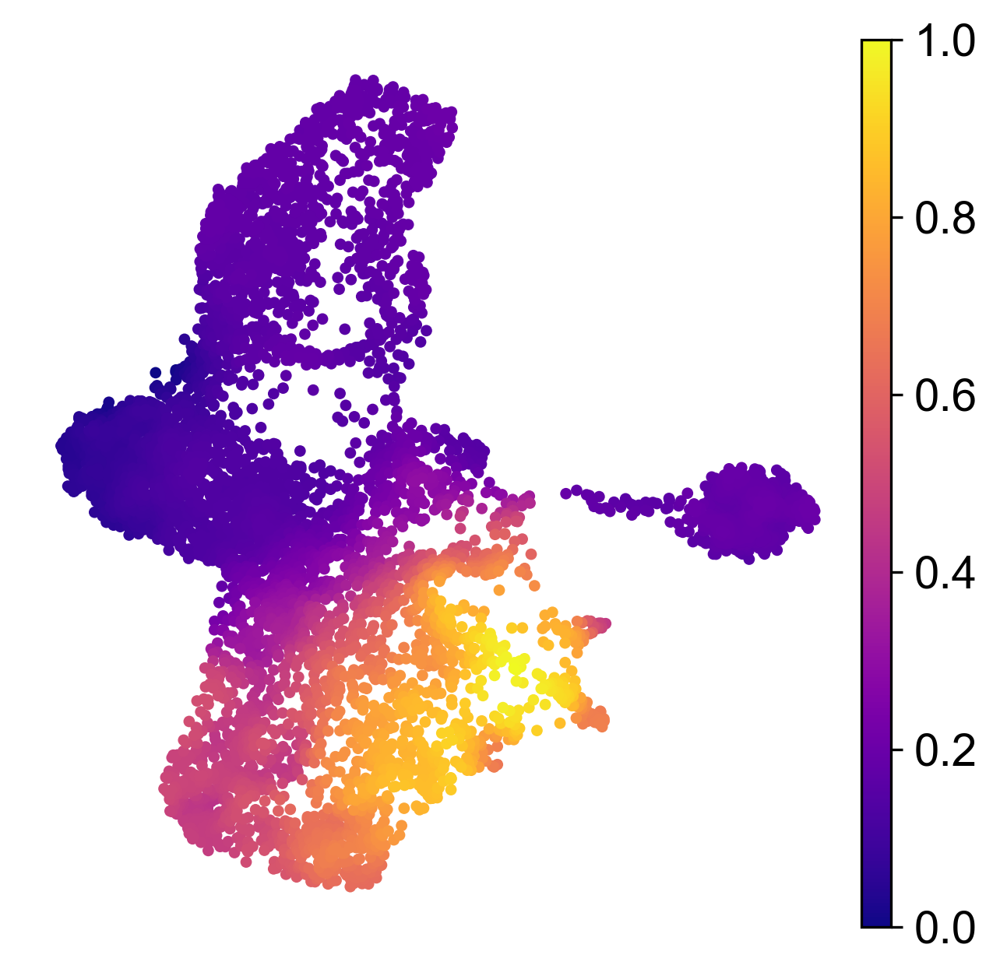

In [175]:
sc.pl.umap(adata, color='Mye',s=50,title='',cmap='plasma',show=False)
plt.savefig('F9.png',dpi=600,bbox_inches='tight')

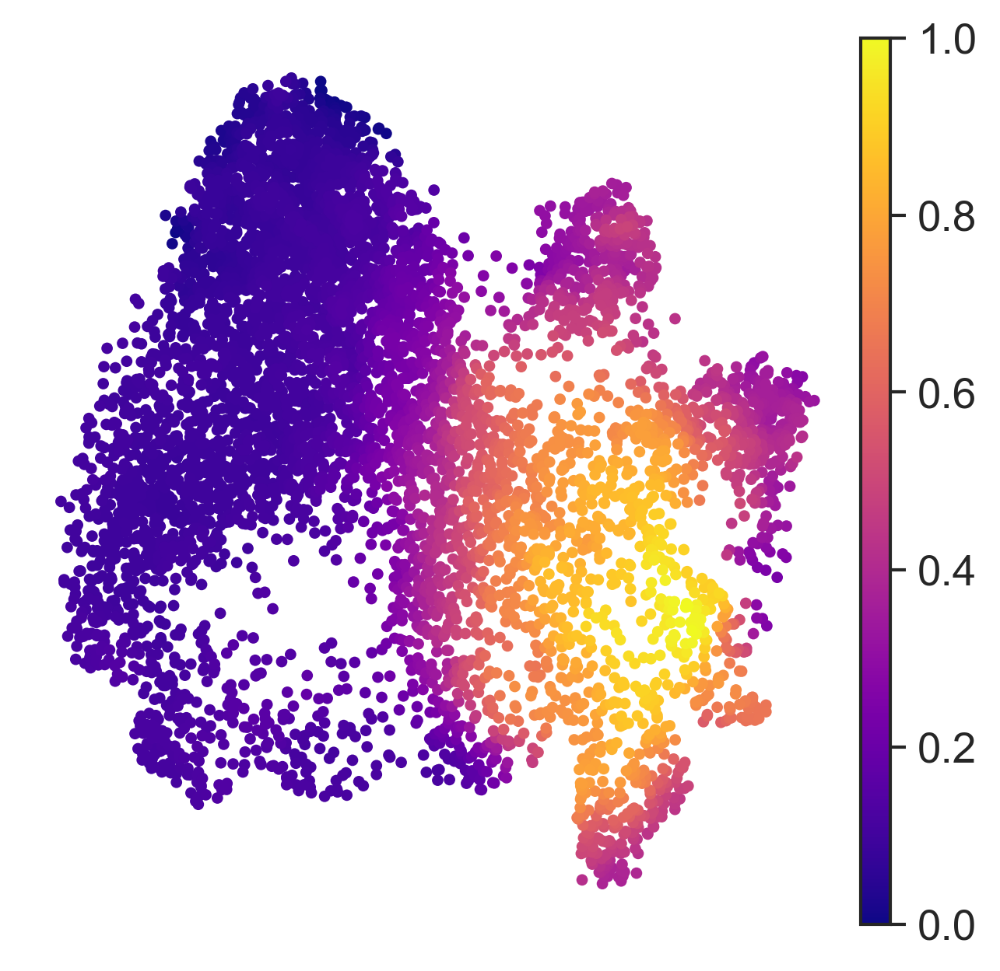

In [221]:
sc.pl.umap(adata1, color='Mye',s=50,title='',cmap='plasma',show=False)
plt.savefig('F10.png',dpi=600,bbox_inches='tight')

In [40]:
FateID = pd.read_csv('FateIDprobs.csv',header=0,index_col=0)

In [44]:
adata.obs['Ery_fateid'] = FateID[['tEry_1','tEry_2','tMega']].mean(axis=1)
adata.obs['Mye_fateid'] = FateID[['tMono_1','tMono_2','tDCs']].mean(axis=1)

In [193]:
FateID1 = pd.read_csv('../../../pheno_FateIDprobs.csv',header=0,index_col=0)

In [207]:
adata1.obs['Ery_fateid'] = FateID1['tMEP'].values
adata1.obs['Mye_fateid'] = FateID1['tGMP'].values

In [201]:
adata1.obs['lin1'] = pr_res1.branch_probs.iloc[:,0]
adata1.obs['lin2'] = pr_res1.branch_probs.iloc[:,1]
adata1.obs['lin3'] = pr_res1.branch_probs.iloc[:,2]
adata1.obs['lin4'] = pr_res1.branch_probs.iloc[:,3]
adata1.obs['lin5'] = pr_res1.branch_probs.iloc[:,4]

In [209]:
adata1.obs['palantir_Ery'] = pr_res1.branch_probs.iloc[:,0]
adata1.obs['palantir_Mye'] = pr_res1.branch_probs.iloc[:,[1,3]].mean(axis=1)


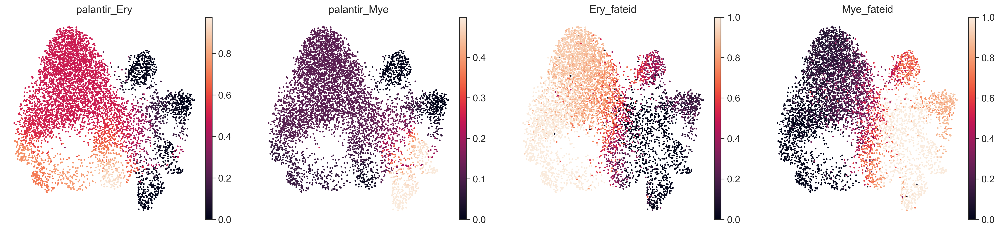

In [222]:
sc.pl.umap(adata1, color=['palantir_Ery','palantir_Mye','Ery_fateid','Mye_fateid'])

In [49]:
for i in range(adata.obsm['palantir_branch_probs'].shape[1]):
    adata.obs[f'palantir_lin{i}'] = adata.obsm['palantir_branch_probs'][:,i]

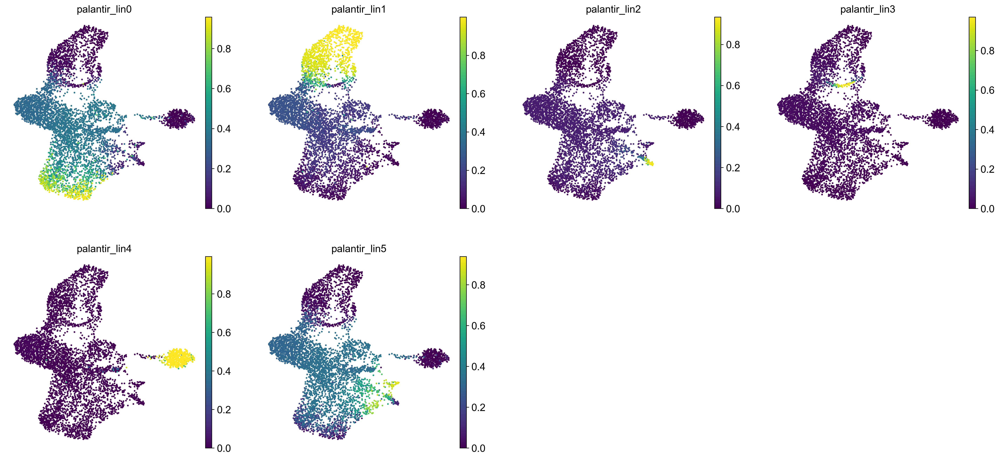

In [50]:
sc.pl.umap(adata, color=[f'palantir_lin{i}' for i in range(6)])

In [51]:
adata.obs['palantir_Ery'] = adata.obsm['palantir_branch_probs'][:,[1,3]].mean(axis=1)
adata.obs['palantir_Mye'] = adata.obsm['palantir_branch_probs'][:,[0,2,5]].mean(axis=1)

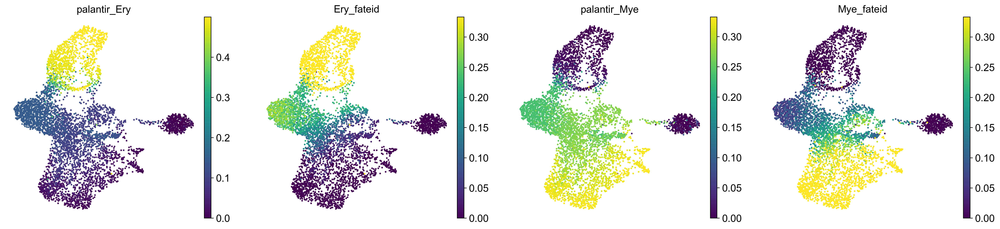

In [54]:
sc.pl.umap(adata, color=['palantir_Ery','Ery_fateid','palantir_Mye','Mye_fateid'])

In [59]:
adata.obs['umap_dis'] = np.linalg.norm(adata.obsm['X_umap'][adata.uns['iroot'],:]-adata.obsm['X_umap'], axis=1)

adata1.obs['umap_dis'] = np.linalg.norm(adata1.obsm['X_umap'][adata1.uns['iroot'],:]-adata1.obsm['X_umap'], axis=1)

In [61]:
adata.obs[['umap_dis','Ery','palantir_Ery','Ery_fateid']].corr()

,umap_dis,Ery,palantir_Ery,Ery_fateid
umap_dis,1.000000,0.098318,-0.228703,-0.565418
Ery,0.098318,1.000000,0.903516,0.683332
palantir_Ery,-0.228703,0.903516,1.000000,0.858363
Ery_fateid,-0.565418,0.683332,0.858363,1.000000


In [62]:
adata.obs[['umap_dis','Ery','palantir_Ery','Ery_fateid']].corr(method='spearman')

,umap_dis,Ery,palantir_Ery,Ery_fateid
umap_dis,1.000000,0.217304,-0.598203,-0.599813
Ery,0.217304,1.000000,0.370568,0.423275
palantir_Ery,-0.598203,0.370568,1.000000,0.940198
Ery_fateid,-0.599813,0.423275,0.940198,1.000000


In [63]:
adata.obs[['umap_dis','Ery','palantir_Ery','Ery_fateid']].corr(method='kendall')

,umap_dis,Ery,palantir_Ery,Ery_fateid
umap_dis,1.000000,0.177310,-0.450463,-0.465661
Ery,0.177310,1.000000,0.242150,0.290237
palantir_Ery,-0.450463,0.242150,1.000000,0.796544
Ery_fateid,-0.465661,0.290237,0.796544,1.000000


In [176]:
adata.obs[['umap_dis','Mye','palantir_Mye','Mye_fateid']].corr()

,umap_dis,Mye,palantir_Mye,Mye_fateid
umap_dis,1.000000,0.489865,-0.241363,0.168013
Mye,0.489865,1.000000,0.517934,0.792049
palantir_Mye,-0.241363,0.517934,1.000000,0.837977
Mye_fateid,0.168013,0.792049,0.837977,1.000000


In [177]:
adata.obs[['umap_dis','Mye','palantir_Mye','Mye_fateid']].corr(method='spearman')

,umap_dis,Mye,palantir_Mye,Mye_fateid
umap_dis,1.000000,0.722406,0.148283,0.172018
Mye,0.722406,1.000000,0.617483,0.660454
palantir_Mye,0.148283,0.617483,1.000000,0.955802
Mye_fateid,0.172018,0.660454,0.955802,1.000000


In [178]:
adata.obs[['umap_dis','Mye','palantir_Mye','Mye_fateid']].corr(method='kendall')

,umap_dis,Mye,palantir_Mye,Mye_fateid
umap_dis,1.000000,0.569801,0.169206,0.188116
Mye,0.569801,1.000000,0.403333,0.472620
palantir_Mye,0.169206,0.403333,1.000000,0.829449
Mye_fateid,0.188116,0.472620,0.829449,1.000000


In [223]:
adata1.obs[['umap_dis','Ery','palantir_Ery','Ery_fateid']].corr()

,umap_dis,Ery,palantir_Ery,Ery_fateid
umap_dis,1.000000,0.277291,-0.241954,-0.606381
Ery,0.277291,1.000000,0.368041,0.428587
palantir_Ery,-0.241954,0.368041,1.000000,0.567192
Ery_fateid,-0.606381,0.428587,0.567192,1.000000


In [224]:
adata1.obs[['umap_dis','Ery','palantir_Ery','Ery_fateid']].corr(method='spearman')

,umap_dis,Ery,palantir_Ery,Ery_fateid
umap_dis,1.000000,0.317487,0.062320,-0.436132
Ery,0.317487,1.000000,0.551669,0.409955
palantir_Ery,0.062320,0.551669,1.000000,0.526824
Ery_fateid,-0.436132,0.409955,0.526824,1.000000


In [225]:
adata1.obs[['umap_dis','Ery','palantir_Ery','Ery_fateid']].corr(method='kendall')

,umap_dis,Ery,palantir_Ery,Ery_fateid
umap_dis,1.000000,0.246639,0.140031,-0.330621
Ery,0.246639,1.000000,0.395373,0.281934
palantir_Ery,0.140031,0.395373,1.000000,0.375852
Ery_fateid,-0.330621,0.281934,0.375852,1.000000


In [226]:
adata1.obs[['umap_dis','Mye','palantir_Mye','Mye_fateid']].corr()

,umap_dis,Mye,palantir_Mye,Mye_fateid
umap_dis,1.000000,0.621515,0.352129,0.606381
Mye,0.621515,1.000000,0.419072,0.882633
palantir_Mye,0.352129,0.419072,1.000000,0.333034
Mye_fateid,0.606381,0.882633,0.333034,1.000000


In [227]:
adata1.obs[['umap_dis','Mye','palantir_Mye','Mye_fateid']].corr(method='spearman')

,umap_dis,Mye,palantir_Mye,Mye_fateid
umap_dis,1.000000,0.690151,-0.153834,0.436132
Mye,0.690151,1.000000,0.159101,0.801490
palantir_Mye,-0.153834,0.159101,1.000000,0.259570
Mye_fateid,0.436132,0.801490,0.259570,1.000000


In [228]:
adata1.obs[['umap_dis','Mye','palantir_Mye','Mye_fateid']].corr(method='kendall')

,umap_dis,Mye,palantir_Mye,Mye_fateid
umap_dis,1.000000,0.500853,-0.158823,0.330621
Mye,0.500853,1.000000,0.083739,0.608485
palantir_Mye,-0.158823,0.083739,1.000000,0.226775
Mye_fateid,0.330621,0.608485,0.226775,1.000000


In [67]:
gres = lineage_rewards(gres, ['HSC_1','HSC_2'], ['Ery_1','Ery_2','Mega'])
gres1 = lineage_rewards(gres1, ['HSC','MPP'], ['MEP'])

In [69]:
t_ery = trainer('ActorCritic', gres, X_latent=X_pca, num_episodes=5e3, gamma=.9)
t_ery.train()

t_ery1 = trainer('ActorCritic', gres1, X_latent=X_pca1, num_episodes=5e3, gamma=.9)
t_ery1.train()

Iteration10: 100%|███████████| 500/500 [00:06<00:00, 78.70it/s, E=5000, R=10.25]


([-1.0,
  -1.0,
  -2.0,
  0.0054347826086956555,
  -1.0,
  -0.22674225951680937,
  -0.2340716616353513,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -2,
  -2,
  -0.2857397851782073,
  0.88742606279873,
  -1.0,
  -1.0,
  -2,
  -0.5026258396566519,
  -1.0,
  -1.0,
  -0.23891929311308546,
  -1.0,
  -1.0,
  -1.0,
  3.22059357898765,
  -0.008152173913043473,
  -1.0,
  -2.0,
  -2.0,
  -1.0,
  -1.0,
  -1.0,
  0.008152173913043471,
  0.7614003644717731,
  0.8207828553709413,
  -1.0,
  0.8357221271754058,
  1.9908581301165156,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  0.008152173913043471,
  0.9375149296822101,
  -1.0,
  -0.028167124967018897,
  0.7393035890851603,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  0.0054347826086956555,
  -2,
  2.588127597041744,
  -1.0,
  -0.03431794535077115,
  -2.0,
  -1.0,
  -0.08214356154310742,
  -1.0,
  -0.2902604043108745,
  -1.0,
  2.7401989410493615,
  -1.0,
  -2,
  -1.0,
  5.804219082865021,
  -0.4581133394024697,
  -1.0,
  0.02717391304

In [70]:
gres.grids['Ery'] = t_ery.agent.critic(torch.tensor(t_ery.env.state_space.mean(axis=1),device=device)).detach().cpu().numpy().ravel()
gres = project_back(gres, 'Ery')
adata.obs['Ery_decision'] = gres.embedding['Ery']

gres1.grids['Ery'] = t_ery1.agent.critic(torch.tensor(t_ery1.env.state_space.mean(axis=1),device=device)).detach().cpu().numpy().ravel()
gres1 = project_back(gres1, 'Ery')
adata1.obs['Ery_decision'] = gres1.embedding['Ery']

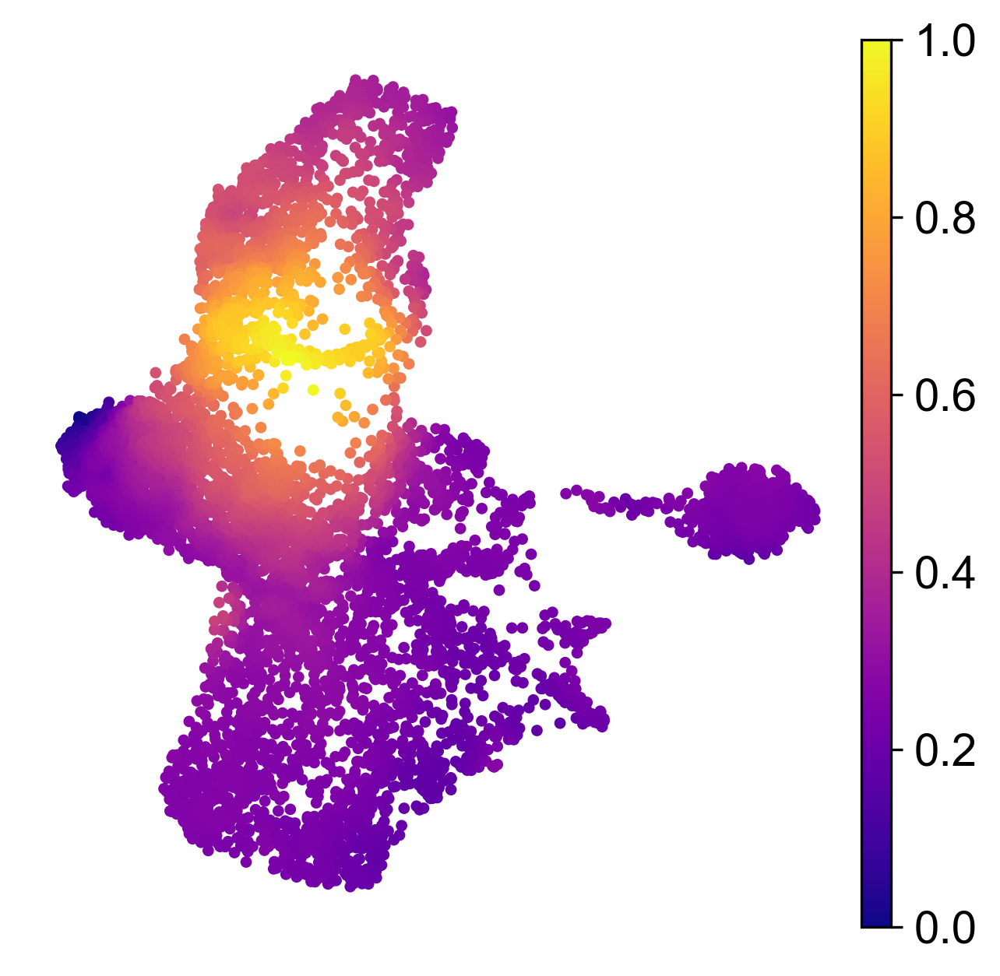

In [71]:
sc.pl.umap(adata, color='Ery_decision',s=50,title='',cmap='plasma',show=False)
plt.savefig('F11.png',dpi=600,bbox_inches='tight')

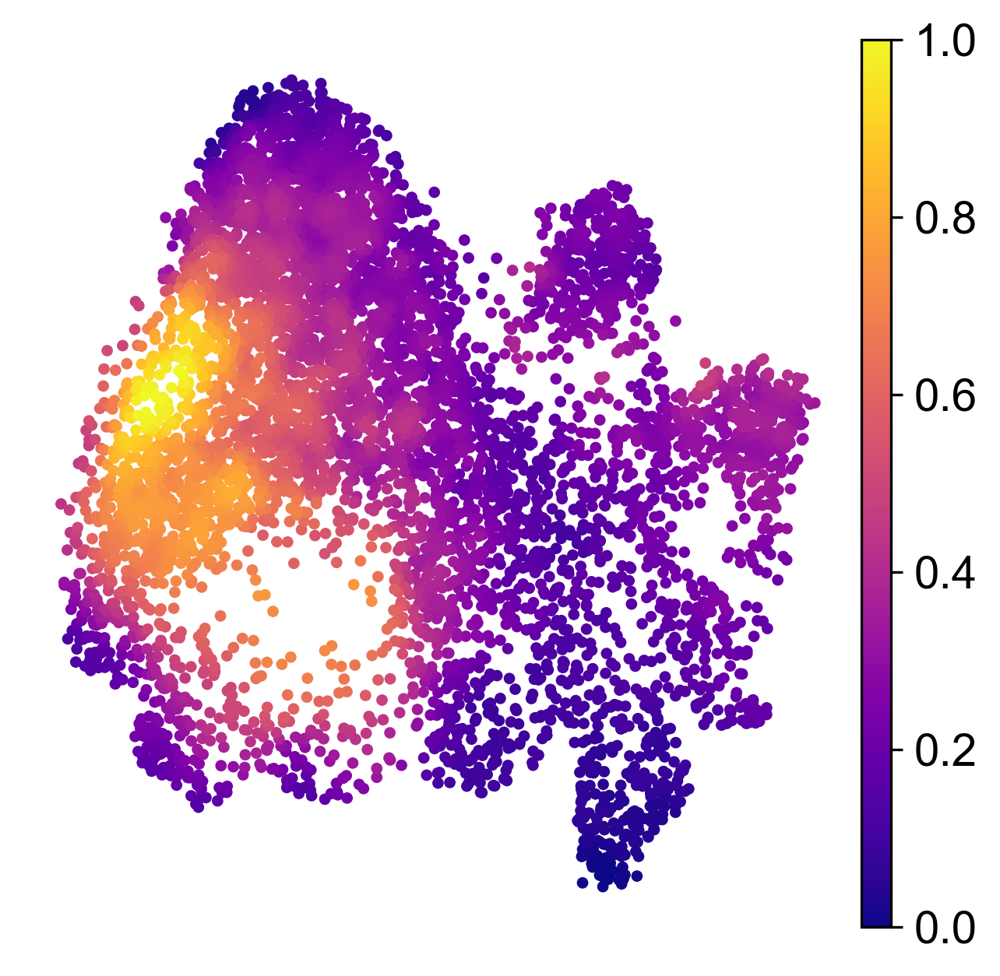

In [72]:
sc.pl.umap(adata1, color='Ery_decision',s=50,title='',cmap='plasma',show=False)
plt.savefig('F12.png',dpi=600,bbox_inches='tight')

In [73]:
gres = lineage_rewards(gres, ['HSC_1','HSC_2'], ['Mono_1','Mono_2','DCs'])
gres1 = lineage_rewards(gres1, ['HSC','MPP'], ['GMP'])

t_mye = trainer('ActorCritic', gres, X_latent=X_pca, num_episodes=5e3, gamma=.9)
t_mye.train()

t_mye1 = trainer('ActorCritic', gres1, X_latent=X_pca1, num_episodes=5e3, gamma=.9)
t_mye1.train()

Reward generating: 100%|██████████████████| 1163/1163 [00:00<00:00, 2470.96it/s]


Time used for generating rewards : 0.49 seconds


Reward generating: 100%|██████████████████| 1699/1699 [00:00<00:00, 2625.32it/s]


Time used for generating rewards : 0.67 seconds


Iteration10: 100%|███████████| 500/500 [00:09<00:00, 52.04it/s, E=5000, R=10.25]


([-1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -2,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  0.002717391304347816,
  -0.019021739130434756,
  -1.0,
  -1.0,
  -0.5441152854195056,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -2,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -2,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  0.5222388781344023,
  -0.2431207367825684,
  -1.0,
  0.021739130434782566,
  -2,
  -1.0,
  -1.0,
  -2.0,
  -1.0,
  -1.0,
  -0.008152173913043473,
  -1.0,
  -1.0,
  -1.0,
  -0.0827277648416741,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  0.0,
  -1.0,
  -1.0,
  -1.0,
  2.374552820553837,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -2,
  -1.0,
  -2.0,
  -1.0,
  0.02717391304347827,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  -1.0,
  

In [78]:
gres.grids['Mye'] = t_mye.agent.critic(torch.tensor(t_mye.env.state_space.mean(axis=1),device=device)).detach().cpu().numpy().ravel()
gres = project_back(gres, 'Mye')
adata.obs['Mye_decision'] = gres.embedding['Mye']

gres1.grids['Mye'] = t_mye1.agent.critic(torch.tensor(t_mye1.env.state_space.mean(axis=1),device=device)).detach().cpu().numpy().ravel()
gres1 = project_back(gres1, 'Mye')
adata1.obs['Mye_decision'] = gres1.embedding['Mye']

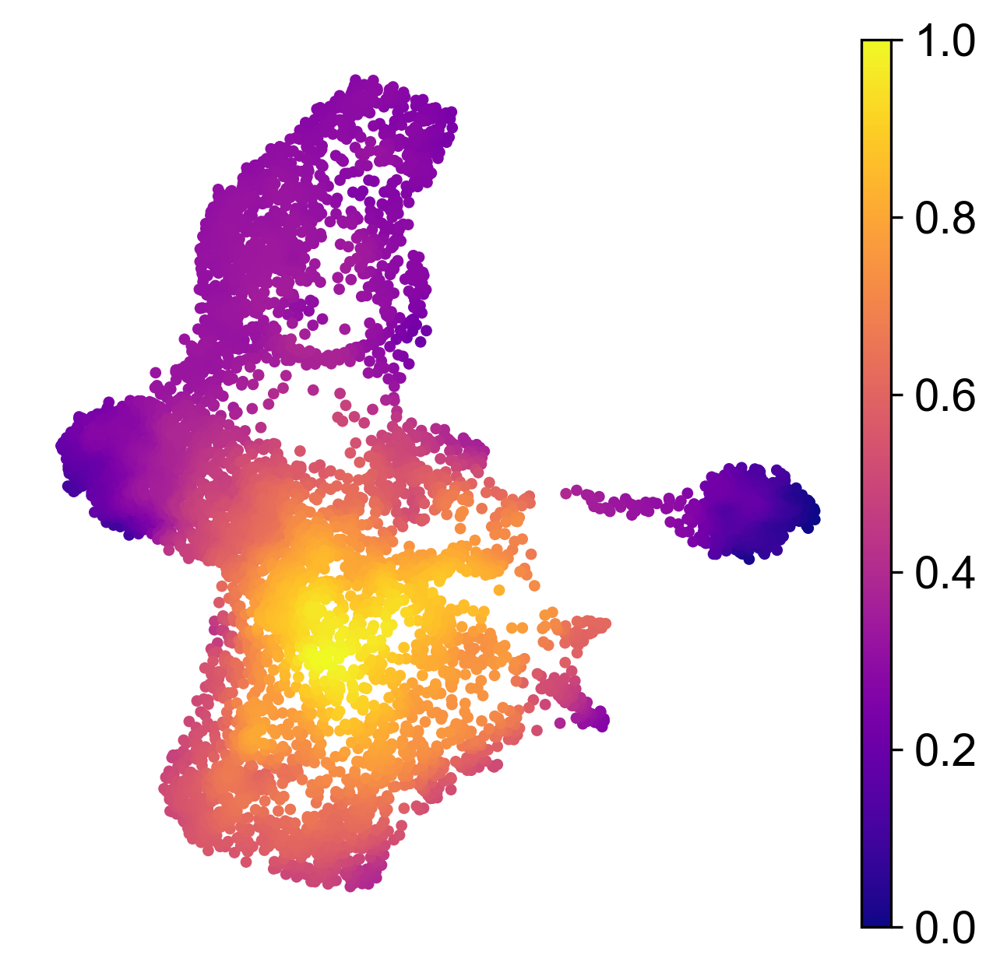

In [79]:
sc.pl.umap(adata, color='Mye_decision',s=50,title='',cmap='plasma',show=False)
plt.savefig('F13.png',dpi=600,bbox_inches='tight')

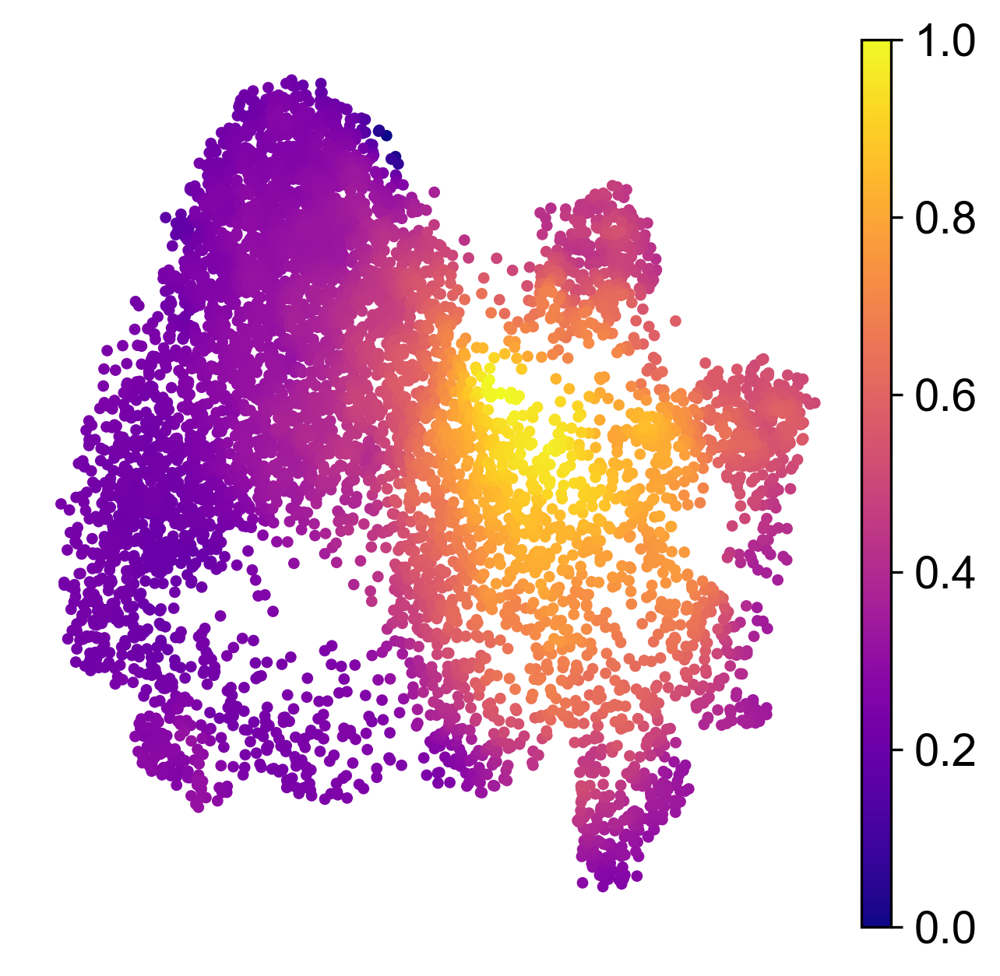

In [80]:
sc.pl.umap(adata1, color='Mye_decision',s=50,title='',cmap='plasma',show=False)
plt.savefig('F14.png',dpi=600,bbox_inches='tight')

In [98]:
from sklearn.preprocessing import KBinsDiscretizer, minmax_scale

In [164]:
ery_df = adata.obs.loc[adata.obs['clusters'].isin(['HSC_1','HSC_2','Ery_1','Ery_2','Mega']),['Ery','Ery_decision','time']]

ery_df['time_bins'] = KBinsDiscretizer(20, encode='ordinal', strategy='quantile').fit_transform(ery_df['time'].values.reshape(-1,1))

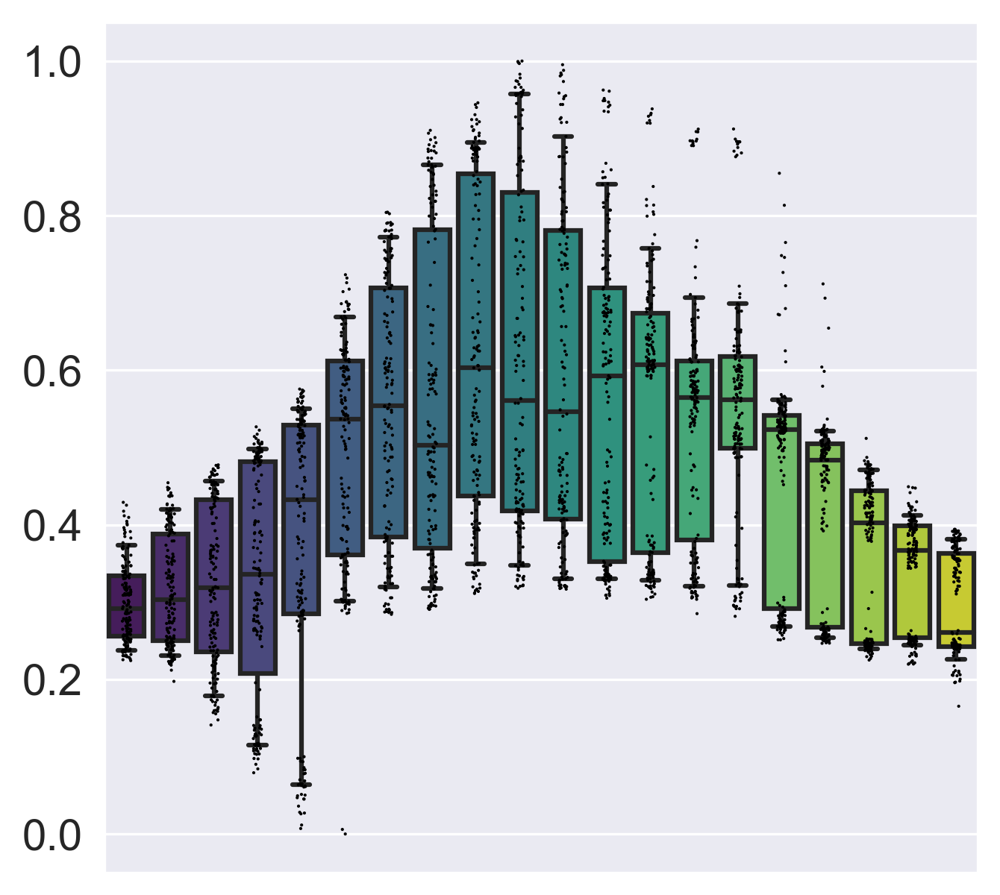

In [165]:
with sns.axes_style('darkgrid'):
    sns.boxplot(data=ery_df,x='time_bins',y='Ery_decision',palette='viridis',fliersize=0,whis=(10,90))
    sns.stripplot(data=ery_df, x='time_bins', y='Ery_decision',color='k',s=1,edgecolor='w')
    ax = plt.gca()
    ax.tick_params(labelbottom=False)
    ax.set_xlabel('')
    ax.set_ylabel('')
    plt.savefig('F15.png',dpi=600,bbox_inches='tight')

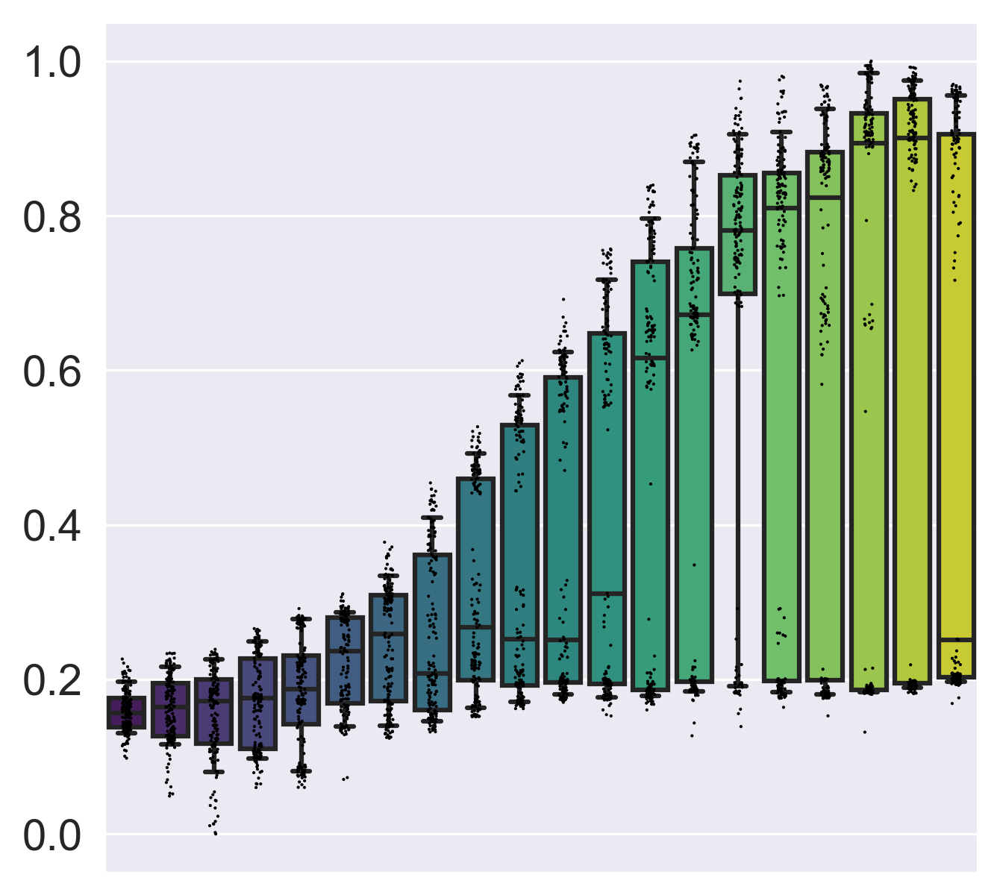

In [166]:
with sns.axes_style('darkgrid'):
    sns.boxplot(data=ery_df,x='time_bins',y='Ery',palette='viridis',fliersize=0,whis=(10,90))
    sns.stripplot(data=ery_df, x='time_bins', y='Ery',color='k',s=1,edgecolor='w')
    ax = plt.gca()
    ax.tick_params(labelbottom=False)
    ax.set_xlabel('')
    ax.set_ylabel('')
    plt.savefig('F16.png',dpi=600,bbox_inches='tight')

In [179]:
mye_df = adata.obs.loc[adata.obs['clusters'].isin(['HSC_1','HSC_2','Mono_1','Mono_2','DCs']),['Mye','Mye_decision','time']]

mye_df['time_bins'] = KBinsDiscretizer(20, encode='ordinal', strategy='quantile').fit_transform(mye_df['time'].values.reshape(-1,1))

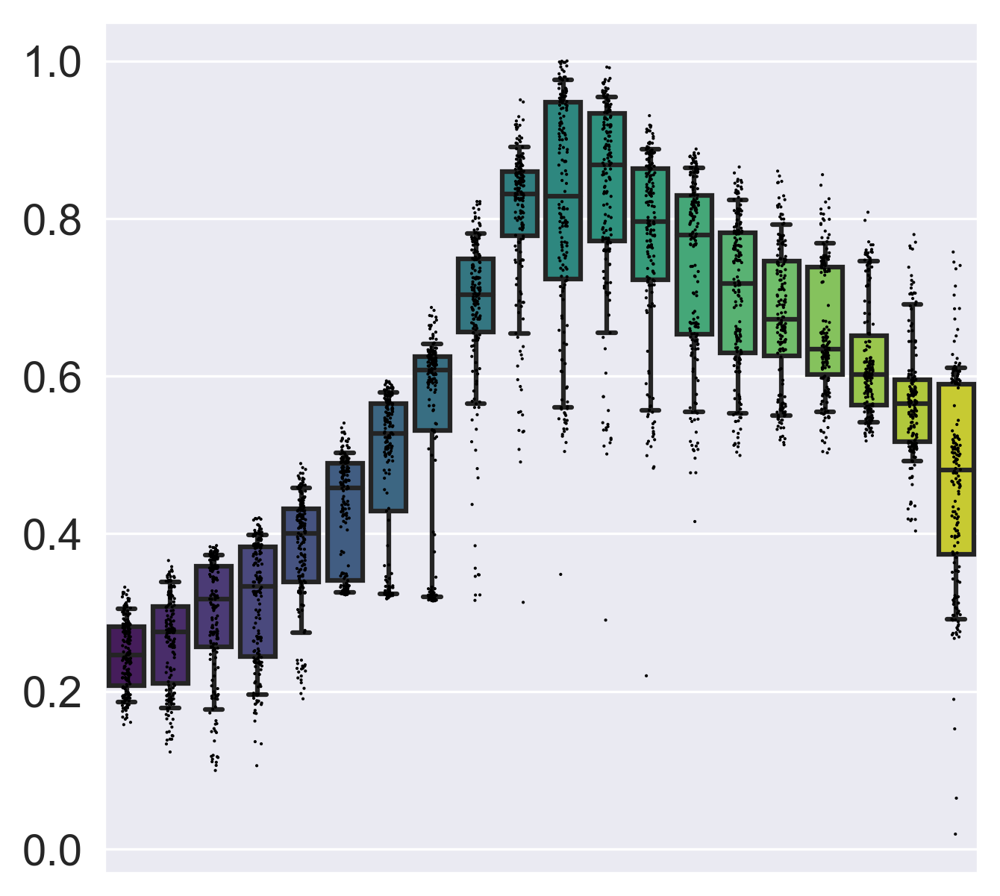

In [180]:
with sns.axes_style('darkgrid'):
    sns.boxplot(data=mye_df,x='time_bins',y='Mye_decision',palette='viridis',fliersize=0,whis=(10,90))
    sns.stripplot(data=mye_df, x='time_bins', y='Mye_decision',color='k',s=1,edgecolor='w')
    ax = plt.gca()
    ax.tick_params(labelbottom=False)
    ax.set_xlabel('')
    ax.set_ylabel('')
    plt.savefig('F17.png',dpi=600,bbox_inches='tight')

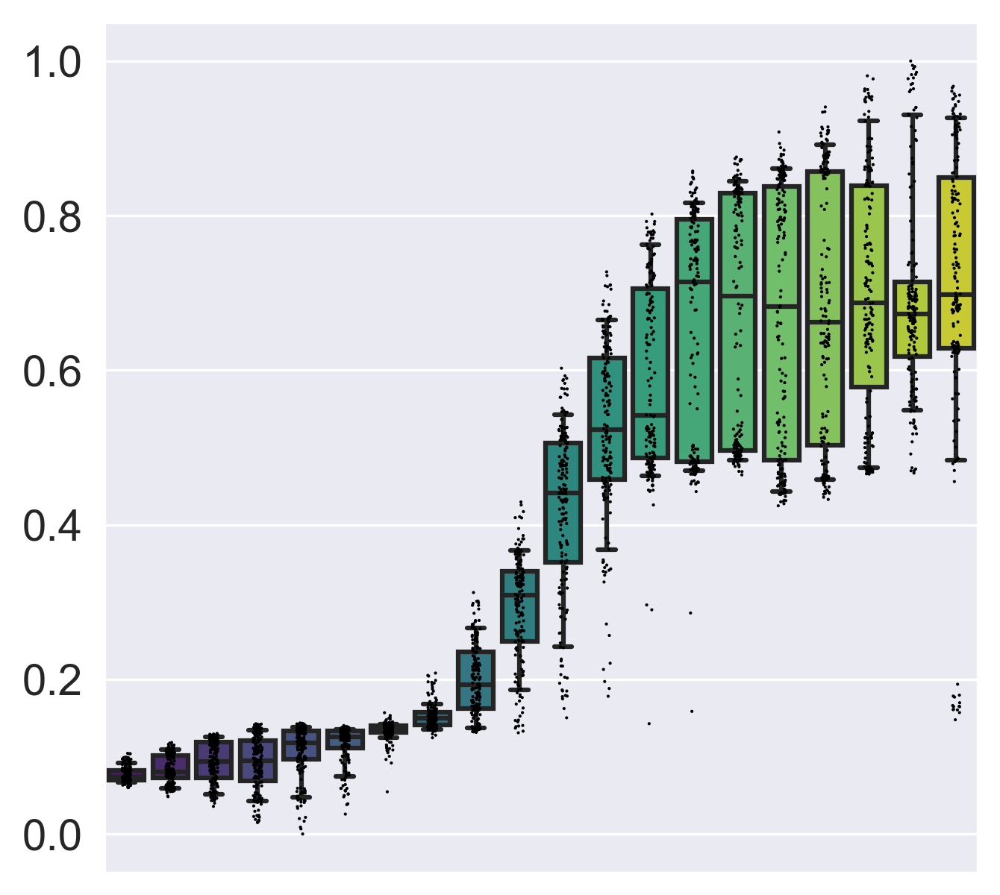

In [188]:
with sns.axes_style('darkgrid'):
    sns.boxplot(data=mye_df,x='time_bins',y='Mye',palette='viridis',fliersize=0,whis=(10,90))
    sns.stripplot(data=mye_df, x='time_bins', y='Mye',color='k',s=1,edgecolor='w')
    ax = plt.gca()
    ax.tick_params(labelbottom=False)
    ax.set_xlabel('')
    ax.set_ylabel('')
    plt.savefig('F18.png',dpi=600,bbox_inches='tight')

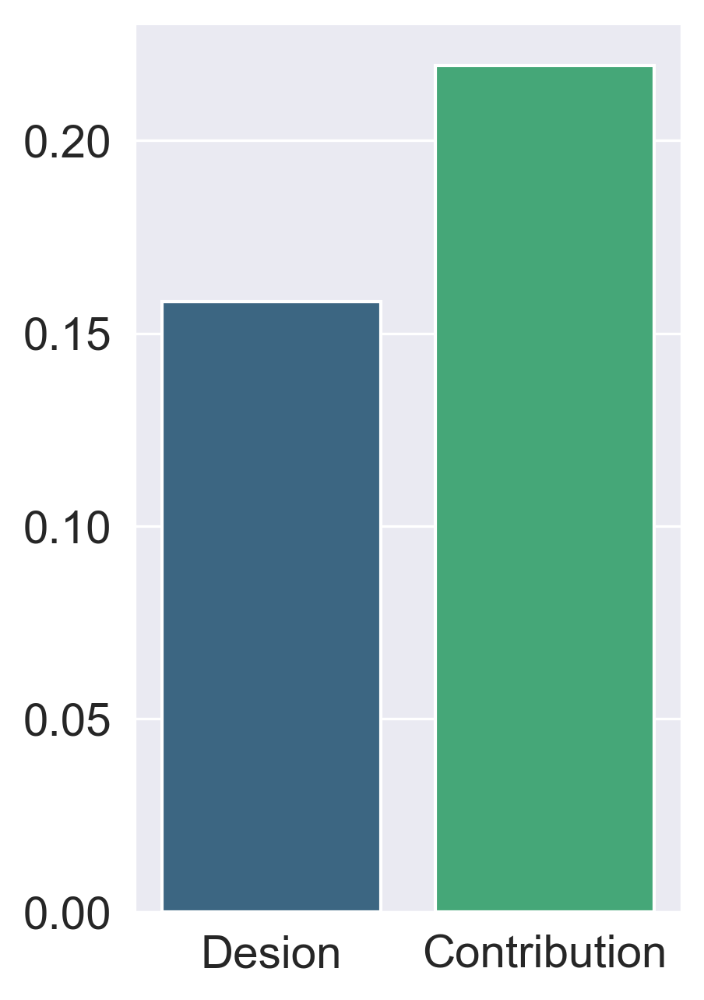

In [191]:
ery_weighted = sum((ery_df['Ery'] / ery_df['Ery'].sum())*ery_df['time'])

eryD_weighted = sum((ery_df['Ery_decision'] / ery_df['Ery_decision'].sum())*ery_df['time'])

with sns.axes_style('darkgrid'):
    fig = plt.figure(figsize=(3,5))
    sns.barplot(x=[0,1],y=[eryD_weighted, ery_weighted],palette='viridis')
    ax = plt.gca()
    ax.set_xticklabels(['Desion','Contribution'])
    plt.savefig('F19.png',dpi=600,bbox_inches='tight')

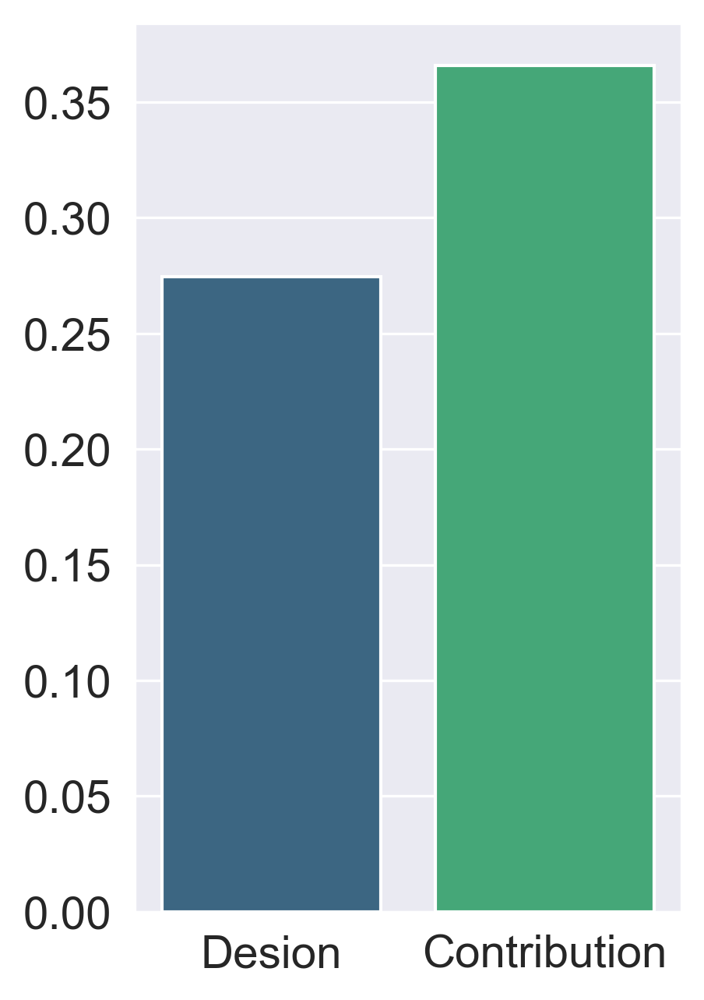

In [192]:
mye_weighted = sum((mye_df['Mye'] / mye_df['Mye'].sum())*mye_df['time'])

myeD_weighted = sum((mye_df['Mye_decision'] / mye_df['Mye_decision'].sum())*mye_df['time'])

with sns.axes_style('darkgrid'):
    fig = plt.figure(figsize=(3,5))
    sns.barplot(x=[0,1],y=[myeD_weighted, mye_weighted],palette='viridis')
    ax = plt.gca()
    ax.set_xticklabels(['Desion','Contribution'])
    plt.savefig('F20.png',dpi=600,bbox_inches='tight')

In [231]:
ery_df1 = adata1.obs.loc[adata1.obs['batch'].isin(['HSC','MPP','MEP']),['Ery','Ery_decision','time']]

ery_df1['time_bins'] = KBinsDiscretizer(20, encode='ordinal', strategy='quantile').fit_transform(ery_df1['time'].values.reshape(-1,1))

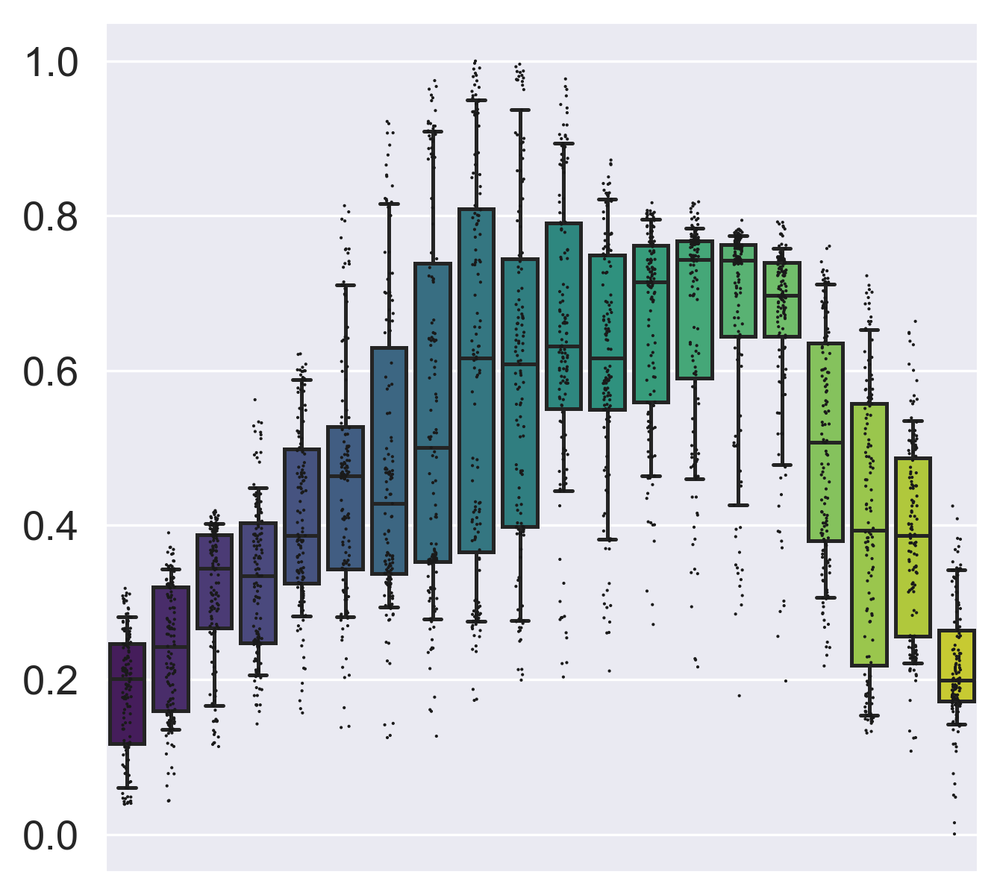

In [235]:
with sns.axes_style('darkgrid'):
    sns.boxplot(data=ery_df1,x='time_bins',y='Ery_decision',palette='viridis',fliersize=0,whis=(10,90))
    sns.stripplot(data=ery_df1, x='time_bins', y='Ery_decision',color='k',s=1,edgecolor='w')
    ax = plt.gca()
    ax.tick_params(labelbottom=False)
    ax.set_xlabel('')
    ax.set_ylabel('')
    plt.savefig('F21.png',dpi=600,bbox_inches='tight')

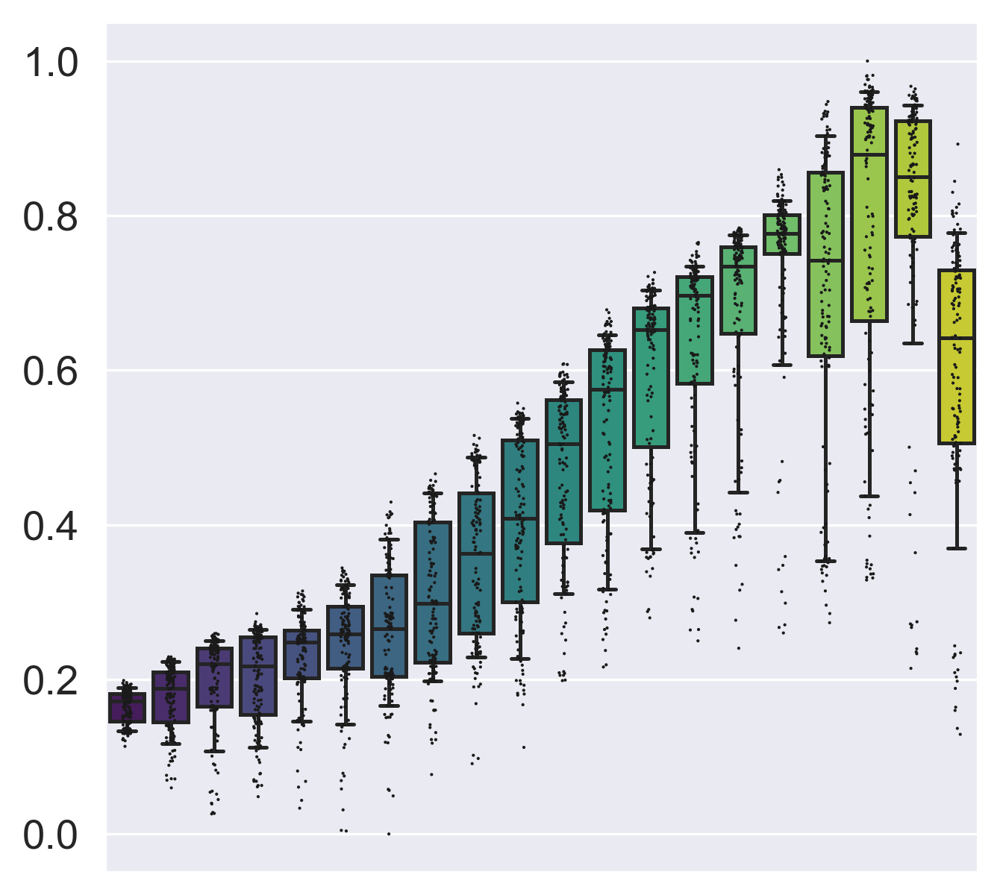

In [236]:
with sns.axes_style('darkgrid'):
    sns.boxplot(data=ery_df1,x='time_bins',y='Ery',palette='viridis',fliersize=0,whis=(10,90))
    sns.stripplot(data=ery_df1, x='time_bins', y='Ery',color='k',s=1,edgecolor='w')
    ax = plt.gca()
    ax.tick_params(labelbottom=False)
    ax.set_xlabel('')
    ax.set_ylabel('')
    plt.savefig('F22.png',dpi=600,bbox_inches='tight')

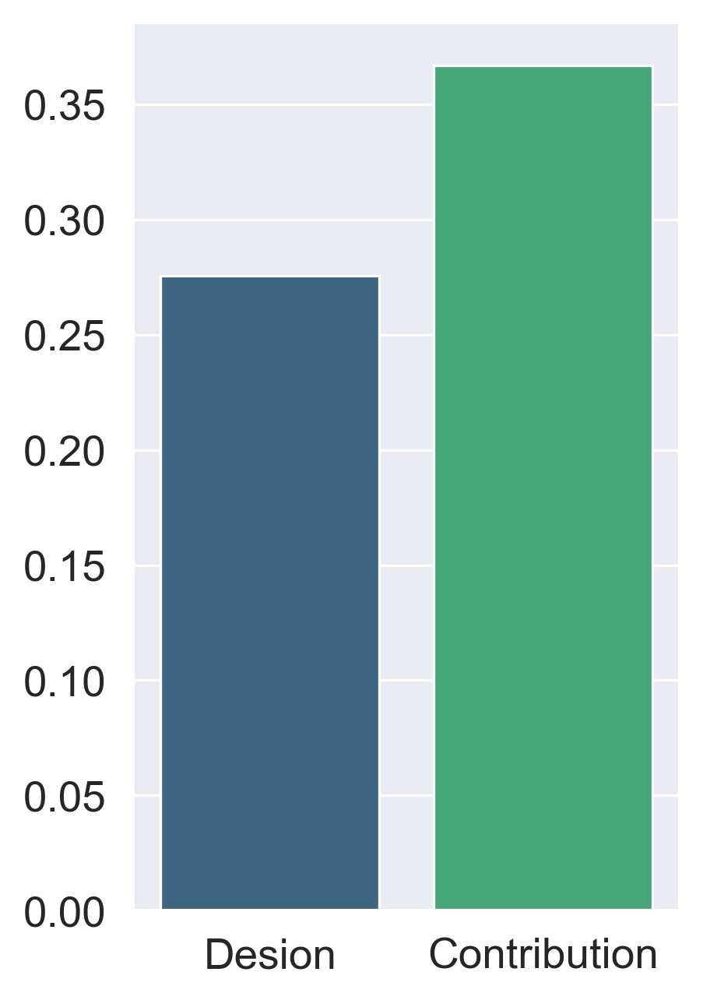

In [237]:
ery_weighted1 = sum((ery_df1['Ery'] / ery_df1['Ery'].sum())*ery_df1['time'])

eryD_weighted1 = sum((ery_df1['Ery_decision'] / ery_df1['Ery_decision'].sum())*ery_df1['time'])

with sns.axes_style('darkgrid'):
    fig = plt.figure(figsize=(3,5))
    sns.barplot(x=[0,1],y=[eryD_weighted1, ery_weighted1],palette='viridis')
    ax = plt.gca()
    ax.set_xticklabels(['Desion','Contribution'])
    plt.savefig('F23.png',dpi=600,bbox_inches='tight')

In [238]:
mye_df1 = adata1.obs.loc[adata1.obs['batch'].isin(['HSC','MPP','GMP']),['Mye','Mye_decision','time']]

mye_df1['time_bins'] = KBinsDiscretizer(20, encode='ordinal', strategy='quantile').fit_transform(mye_df1['time'].values.reshape(-1,1))

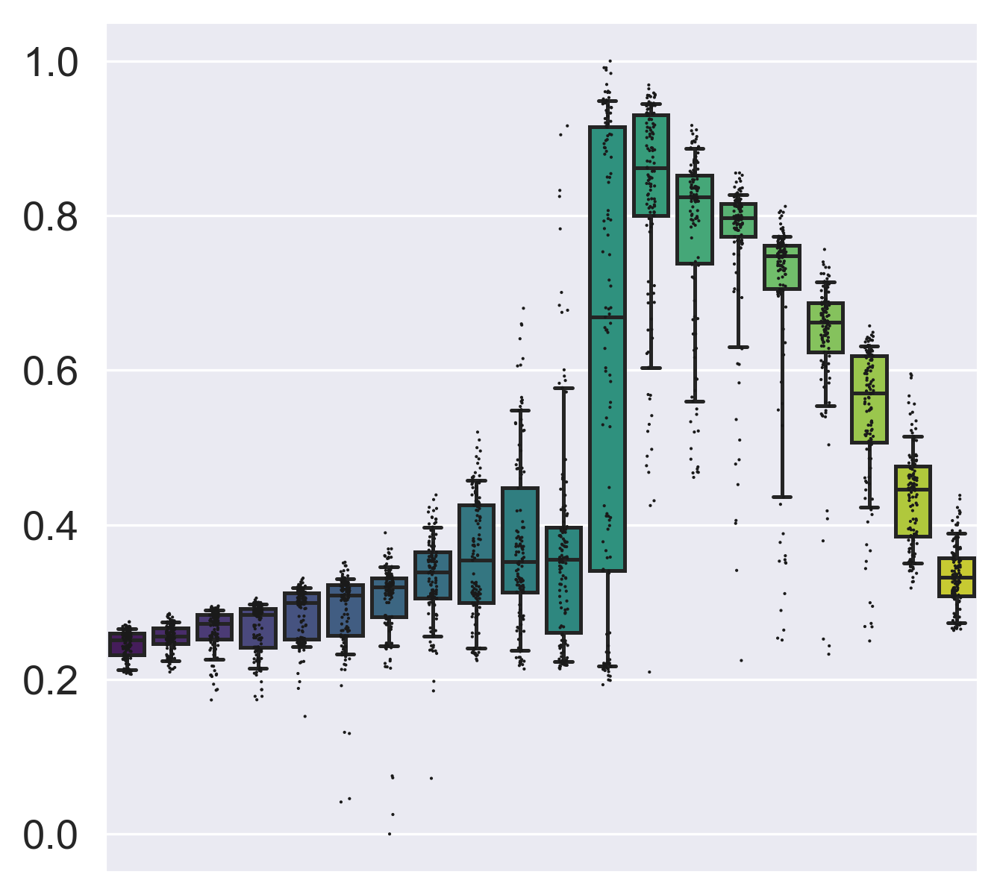

In [239]:
with sns.axes_style('darkgrid'):
    sns.boxplot(data=mye_df1,x='time_bins',y='Mye_decision',palette='viridis',fliersize=0,whis=(10,90))
    sns.stripplot(data=mye_df1, x='time_bins', y='Mye_decision',color='k',s=1,edgecolor='w')
    ax = plt.gca()
    ax.tick_params(labelbottom=False)
    ax.set_xlabel('')
    ax.set_ylabel('')
    plt.savefig('F24.png',dpi=600,bbox_inches='tight')

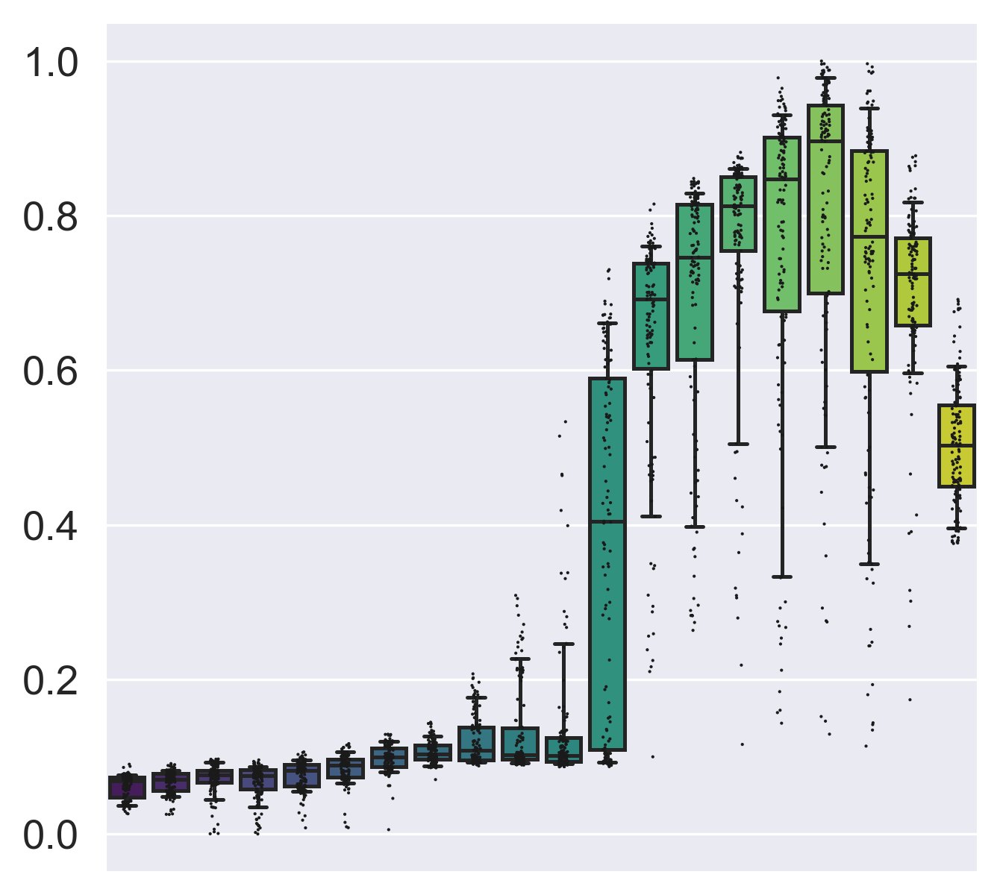

In [240]:
with sns.axes_style('darkgrid'):
    sns.boxplot(data=mye_df1,x='time_bins',y='Mye',palette='viridis',fliersize=0,whis=(10,90))
    sns.stripplot(data=mye_df1, x='time_bins', y='Mye',color='k',s=1,edgecolor='w')
    ax = plt.gca()
    ax.tick_params(labelbottom=False)
    ax.set_xlabel('')
    ax.set_ylabel('')
    plt.savefig('F25.png',dpi=600,bbox_inches='tight')

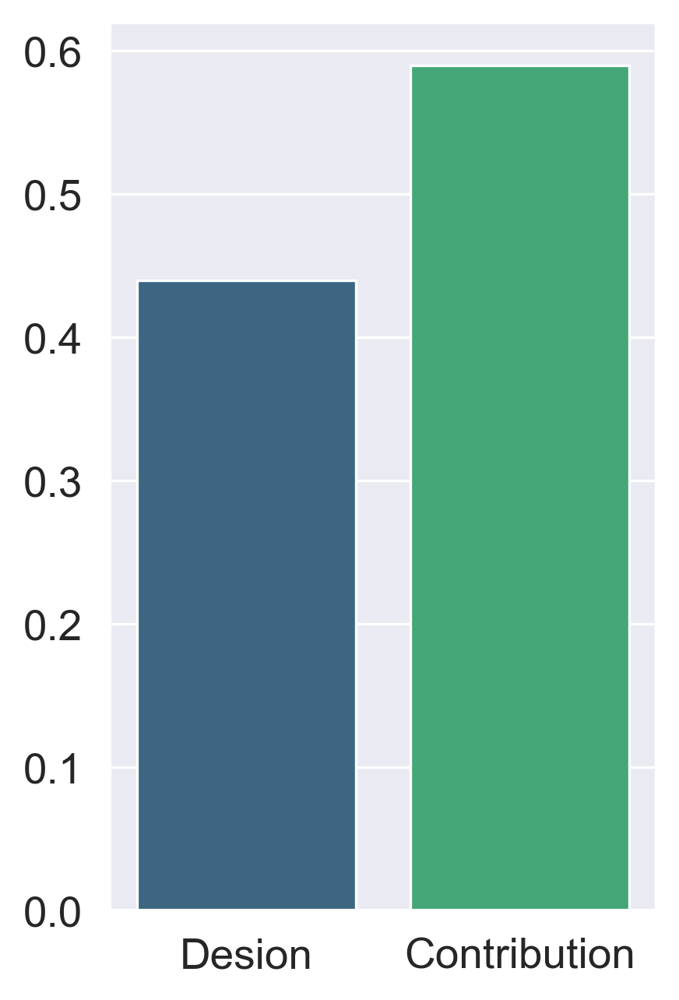

In [241]:
mye_weighted1 = sum((mye_df1['Mye'] / mye_df1['Mye'].sum())*mye_df1['time'])

myeD_weighted1 = sum((mye_df1['Mye_decision'] / mye_df1['Mye_decision'].sum())*mye_df1['time'])

with sns.axes_style('darkgrid'):
    fig = plt.figure(figsize=(3,5))
    sns.barplot(x=[0,1],y=[myeD_weighted1, mye_weighted1],palette='viridis')
    ax = plt.gca()
    ax.set_xticklabels(['Desion','Contribution'])
    plt.savefig('F26.png',dpi=600,bbox_inches='tight')

In [242]:
adata.obs.to_csv('0326_cd34.csv')

In [243]:
adata1.obs.to_csv('0326_pheno.csv')